# Sentiment Classification & How To "Frame Problems" for a Neural Network

by Andrew Trask

- **Twitter**: @iamtrask
- **Blog**: http://iamtrask.github.io

### What You Should Already Know

- neural networks, forward and back-propagation
- stochastic gradient descent
- mean squared error
- and train/test splits

### Where to Get Help if You Need it
- Re-watch previous Udacity Lectures
- Leverage the recommended Course Reading Material - [Grokking Deep Learning](https://www.manning.com/books/grokking-deep-learning) (Check inside your classroom for a discount code)
- Shoot me a tweet @iamtrask


### Tutorial Outline:

- Intro: The Importance of "Framing a Problem" (this lesson)

- [Curate a Dataset](#lesson_1)
- [Developing a "Predictive Theory"](#lesson_2)
- [**PROJECT 1**: Quick Theory Validation](#project_1)


- [Transforming Text to Numbers](#lesson_3)
- [**PROJECT 2**: Creating the Input/Output Data](#project_2)


- Putting it all together in a Neural Network (video only - nothing in notebook)
- [**PROJECT 3**: Building our Neural Network](#project_3)


- [Understanding Neural Noise](#lesson_4)
- [**PROJECT 4**: Making Learning Faster by Reducing Noise](#project_4)


- [Analyzing Inefficiencies in our Network](#lesson_5)
- [**PROJECT 5**: Making our Network Train and Run Faster](#project_5)


- [Further Noise Reduction](#lesson_6)
- [**PROJECT 6**: Reducing Noise by Strategically Reducing the Vocabulary](#project_6)


- [Analysis: What's going on in the weights?](#lesson_7)

# Lesson: Curate a Dataset<a id='lesson_1'></a>
The cells from here until Project 1 include code Andrew shows in the videos leading up to mini project 1. We've included them so you can run the code along with the videos without having to type in everything.

In [1]:
def pretty_print_review_and_label(i):
    print(labels[i] + "\t:\t" + reviews[i][:80] + "...")

g = open('reviews.txt','r') # What we know!
reviews = list(map(lambda x:x[:-1],g.readlines()))
g.close()

g = open('labels.txt','r') # What we WANT to know!
labels = list(map(lambda x:x[:-1].upper(),g.readlines()))
g.close()

**Note:** The data in `reviews.txt` we're using has already been preprocessed a bit and contains only lower case characters. If we were working from raw data, where we didn't know it was all lower case, we would want to add a step here to convert it. That's so we treat different variations of the same word, like `The`, `the`, and `THE`, all the same way.

In [2]:
len(reviews)

25000

In [3]:
reviews[0]

'bromwell high is a cartoon comedy . it ran at the same time as some other programs about school life  such as  teachers  . my   years in the teaching profession lead me to believe that bromwell high  s satire is much closer to reality than is  teachers  . the scramble to survive financially  the insightful students who can see right through their pathetic teachers  pomp  the pettiness of the whole situation  all remind me of the schools i knew and their students . when i saw the episode in which a student repeatedly tried to burn down the school  i immediately recalled . . . . . . . . . at . . . . . . . . . . high . a classic line inspector i  m here to sack one of your teachers . student welcome to bromwell high . i expect that many adults of my age think that bromwell high is far fetched . what a pity that it isn  t   '

In [4]:
labels[0]

'POSITIVE'

# Lesson: Develop a Predictive Theory<a id='lesson_2'></a>

In [5]:
print("labels.txt \t : \t reviews.txt\n")
pretty_print_review_and_label(2137)
pretty_print_review_and_label(12816)
pretty_print_review_and_label(6267)
pretty_print_review_and_label(21934)
pretty_print_review_and_label(5297)
pretty_print_review_and_label(4998)

labels.txt 	 : 	 reviews.txt

NEGATIVE	:	this movie is terrible but it has some good effects .  ...
POSITIVE	:	adrian pasdar is excellent is this film . he makes a fascinating woman .  ...
NEGATIVE	:	comment this movie is impossible . is terrible  very improbable  bad interpretat...
POSITIVE	:	excellent episode movie ala pulp fiction .  days   suicides . it doesnt get more...
NEGATIVE	:	if you haven  t seen this  it  s terrible . it is pure trash . i saw this about ...
POSITIVE	:	this schiffer guy is a real genius  the movie is of excellent quality and both e...


# Project 1: Quick Theory Validation<a id='project_1'></a>

There are multiple ways to implement these projects, but in order to get your code closer to what Andrew shows in his solutions, we've provided some hints and starter code throughout this notebook.

You'll find the [Counter](https://docs.python.org/2/library/collections.html#collections.Counter) class to be useful in this exercise, as well as the [numpy](https://docs.scipy.org/doc/numpy/reference/) library.

In [6]:
from collections import Counter
import numpy as np

We'll create three `Counter` objects, one for words from postive reviews, one for words from negative reviews, and one for all the words.

In [7]:
# Create three Counter objects to store positive, negative and total counts
positive_counts = Counter()
negative_counts = Counter()
total_counts = Counter()

**TODO:** Examine all the reviews. For each word in a positive review, increase the count for that word in both your positive counter and the total words counter; likewise, for each word in a negative review, increase the count for that word in both your negative counter and the total words counter.

**Note:** Throughout these projects, you should use `split(' ')` to divide a piece of text (such as a review) into individual words. If you use `split()` instead, you'll get slightly different results than what the videos and solutions show.

In [8]:
# TODO: Loop over all the words in all the reviews and increment the counts in the appropriate counter objects

for review,label in zip(reviews,labels):
    
    split_review = review.split(' ')
    
    for word in split_review:
        
        if label == 'POSITIVE':
            positive_counts[word] +=1
        else:
            negative_counts[word] +=1
        total_counts[word] +=1


In [9]:
len(total_counts)

74074

Run the following two cells to list the words used in positive reviews and negative reviews, respectively, ordered from most to least commonly used. 

In [10]:
# Examine the counts of the most common words in positive reviews
positive_counts.most_common()

[('', 550468),
 ('the', 173324),
 ('.', 159654),
 ('and', 89722),
 ('a', 83688),
 ('of', 76855),
 ('to', 66746),
 ('is', 57245),
 ('in', 50215),
 ('br', 49235),
 ('it', 48025),
 ('i', 40743),
 ('that', 35630),
 ('this', 35080),
 ('s', 33815),
 ('as', 26308),
 ('with', 23247),
 ('for', 22416),
 ('was', 21917),
 ('film', 20937),
 ('but', 20822),
 ('movie', 19074),
 ('his', 17227),
 ('on', 17008),
 ('you', 16681),
 ('he', 16282),
 ('are', 14807),
 ('not', 14272),
 ('t', 13720),
 ('one', 13655),
 ('have', 12587),
 ('be', 12416),
 ('by', 11997),
 ('all', 11942),
 ('who', 11464),
 ('an', 11294),
 ('at', 11234),
 ('from', 10767),
 ('her', 10474),
 ('they', 9895),
 ('has', 9186),
 ('so', 9154),
 ('like', 9038),
 ('about', 8313),
 ('very', 8305),
 ('out', 8134),
 ('there', 8057),
 ('she', 7779),
 ('what', 7737),
 ('or', 7732),
 ('good', 7720),
 ('more', 7521),
 ('when', 7456),
 ('some', 7441),
 ('if', 7285),
 ('just', 7152),
 ('can', 7001),
 ('story', 6780),
 ('time', 6515),
 ('my', 6488),
 ('g

In [11]:
# Examine the counts of the most common words in negative reviews
negative_counts.most_common()

[('', 561462),
 ('.', 167538),
 ('the', 163389),
 ('a', 79321),
 ('and', 74385),
 ('of', 69009),
 ('to', 68974),
 ('br', 52637),
 ('is', 50083),
 ('it', 48327),
 ('i', 46880),
 ('in', 43753),
 ('this', 40920),
 ('that', 37615),
 ('s', 31546),
 ('was', 26291),
 ('movie', 24965),
 ('for', 21927),
 ('but', 21781),
 ('with', 20878),
 ('as', 20625),
 ('t', 20361),
 ('film', 19218),
 ('you', 17549),
 ('on', 17192),
 ('not', 16354),
 ('have', 15144),
 ('are', 14623),
 ('be', 14541),
 ('he', 13856),
 ('one', 13134),
 ('they', 13011),
 ('at', 12279),
 ('his', 12147),
 ('all', 12036),
 ('so', 11463),
 ('like', 11238),
 ('there', 10775),
 ('just', 10619),
 ('by', 10549),
 ('or', 10272),
 ('an', 10266),
 ('who', 9969),
 ('from', 9731),
 ('if', 9518),
 ('about', 9061),
 ('out', 8979),
 ('what', 8422),
 ('some', 8306),
 ('no', 8143),
 ('her', 7947),
 ('even', 7687),
 ('can', 7653),
 ('has', 7604),
 ('good', 7423),
 ('bad', 7401),
 ('would', 7036),
 ('up', 6970),
 ('only', 6781),
 ('more', 6730),
 ('

As you can see, common words like "the" appear very often in both positive and negative reviews. Instead of finding the most common words in positive or negative reviews, what you really want are the words found in positive reviews more often than in negative reviews, and vice versa. To accomplish this, you'll need to calculate the **ratios** of word usage between positive and negative reviews.

**TODO:** Check all the words you've seen and calculate the ratio of postive to negative uses and store that ratio in `pos_neg_ratios`. 
>Hint: the positive-to-negative ratio for a given word can be calculated with `positive_counts[word] / float(negative_counts[word]+1)`. Notice the `+1` in the denominator – that ensures we don't divide by zero for words that are only seen in positive reviews.

In [37]:
# Create Counter object to store positive/negative ratios
pos_neg_ratios = Counter()

for word in total_counts:
    if total_counts[word] > 50:
        if word in positive_counts and word in negative_counts:        
            pos_neg_ratios[word] = positive_counts[word]/(negative_counts[word] +1)

        elif word in positive_counts and word not in negative_counts:
            pos_neg_ratios[word] = positive_counts[word]
        else:
            pos_neg_ratios[word] = 0
# TODO: Calculate the ratios of positive and negative uses of the most common words
#       Consider words to be "common" if they've been used at least 100 times

Examine the ratios you've calculated for a few words:

In [38]:
print("Pos-to-neg ratio for 'the' = {}".format(pos_neg_ratios["the"]))
print("Pos-to-neg ratio for 'amazing' = {}".format(pos_neg_ratios["amazing"]))
print("Pos-to-neg ratio for 'terrible' = {}".format(pos_neg_ratios["terrible"]))

Pos-to-neg ratio for 'the' = 1.0607993145235326
Pos-to-neg ratio for 'amazing' = 4.022813688212928
Pos-to-neg ratio for 'terrible' = 0.17744252873563218


Looking closely at the values you just calculated, we see the following:

* Words that you would expect to see more often in positive reviews – like "amazing" – have a ratio greater than 1. The more skewed a word is toward postive, the farther from 1 its positive-to-negative ratio  will be.
* Words that you would expect to see more often in negative reviews – like "terrible" – have positive values that are less than 1. The more skewed a word is toward negative, the closer to zero its positive-to-negative ratio will be.
* Neutral words, which don't really convey any sentiment because you would expect to see them in all sorts of reviews – like "the" – have values very close to 1. A perfectly neutral word – one that was used in exactly the same number of positive reviews as negative reviews – would be almost exactly 1. The `+1` we suggested you add to the denominator slightly biases words toward negative, but it won't matter because it will be a tiny bias and later we'll be ignoring words that are too close to neutral anyway.

Ok, the ratios tell us which words are used more often in postive or negative reviews, but the specific values we've calculated are a bit difficult to work with. A very positive word like "amazing" has a value above 4, whereas a very negative word like "terrible" has a value around 0.18. Those values aren't easy to compare for a couple of reasons:

* Right now, 1 is considered neutral, but the absolute value of the postive-to-negative rations of very postive words is larger than the absolute value of the ratios for the very negative words. So there is no way to directly compare two numbers and see if one word conveys the same magnitude of positive sentiment as another word conveys negative sentiment. So we should center all the values around netural so the absolute value from neutral of the postive-to-negative ratio for a word would indicate how much sentiment (positive or negative) that word conveys.
* When comparing absolute values it's easier to do that around zero than one. 

To fix these issues, we'll convert all of our ratios to new values using logarithms.

**TODO:** Go through all the ratios you calculated and convert them to logarithms. (i.e. use `np.log(ratio)`)

In the end, extremely positive and extremely negative words will have positive-to-negative ratios with similar magnitudes but opposite signs.

In [39]:
# TODO: Convert ratios to logs

for word,value in pos_neg_ratios.items():
    pos_neg_ratios[word] = np.log(value)

In [40]:
pos_neg_ratios.most_common()

[('edie', 4.6913478822291435),
 ('antwone', 4.4773368144782069),
 ('din', 4.4067192472642533),
 ('gunga', 4.1896547420264252),
 ('goldsworthy', 4.1743872698956368),
 ('gypo', 4.0943445622221004),
 ('yokai', 4.0943445622221004),
 ('paulie', 4.0775374439057197),
 ('visconti', 3.9318256327243257),
 ('flavia', 3.9318256327243257),
 ('gundam', 3.4231762883809305),
 ('iturbi', 3.2771447329921766),
 ('felix', 3.1527360223636558),
 ('capote', 3.0122615755052013),
 ('fido', 3.0081547935525483),
 ('excellently', 2.9789251552376097),
 ('vance', 2.9444389791664403),
 ('kolchak', 2.9311937524164198),
 ('deanna', 2.9267394020670396),
 ('hayworth', 2.9267394020670396),
 ('sammo', 2.8526314299133175),
 ('sox', 2.8332133440562162),
 ('laputa', 2.8332133440562162),
 ('biko', 2.8332133440562162),
 ('polanski', 2.8233610476132043),
 ('alvin', 2.8183982582710754),
 ('matthau', 2.8067217286092401),
 ('mathieu', 2.7725887222397811),
 ('gilliam', 2.7245795030534206),
 ('victoria', 2.6810215287142909),
 ('chav

Examine the new ratios you've calculated for the same words from before:

In [41]:
print("Pos-to-neg ratio for 'the' = {}".format(pos_neg_ratios["the"]))
print("Pos-to-neg ratio for 'amazing' = {}".format(pos_neg_ratios["amazing"]))
print("Pos-to-neg ratio for 'terrible' = {}".format(pos_neg_ratios["terrible"]))

Pos-to-neg ratio for 'the' = 0.05902269426102881
Pos-to-neg ratio for 'amazing' = 1.3919815802404802
Pos-to-neg ratio for 'terrible' = -1.7291085042663878


If everything worked, now you should see neutral words with values close to zero. In this case, "the" is near zero but slightly positive, so it was probably used in more positive reviews than negative reviews. But look at "amazing"'s ratio - it's above `1`, showing it is clearly a word with positive sentiment. And "terrible" has a similar score, but in the opposite direction, so it's below `-1`. It's now clear that both of these words are associated with specific, opposing sentiments.

Now run the following cells to see more ratios. 

The first cell displays all the words, ordered by how associated they are with postive reviews. (Your notebook will most likely truncate the output so you won't actually see *all* the words in the list.)

The second cell displays the 30 words most associated with negative reviews by reversing the order of the first list and then looking at the first 30 words. (If you want the second cell to display all the words, ordered by how associated they are with negative reviews, you could just write `reversed(pos_neg_ratios.most_common())`.)

You should continue to see values similar to the earlier ones we checked – neutral words will be close to `0`, words will get more positive as their ratios approach and go above `1`, and words will get more negative as their ratios approach and go below `-1`. That's why we decided to use the logs instead of the raw ratios.

In [42]:
# words most frequently seen in a review with a "POSITIVE" label
pos_neg_ratios.most_common()

[('edie', 4.6913478822291435),
 ('antwone', 4.4773368144782069),
 ('din', 4.4067192472642533),
 ('gunga', 4.1896547420264252),
 ('goldsworthy', 4.1743872698956368),
 ('gypo', 4.0943445622221004),
 ('yokai', 4.0943445622221004),
 ('paulie', 4.0775374439057197),
 ('visconti', 3.9318256327243257),
 ('flavia', 3.9318256327243257),
 ('gundam', 3.4231762883809305),
 ('iturbi', 3.2771447329921766),
 ('felix', 3.1527360223636558),
 ('capote', 3.0122615755052013),
 ('fido', 3.0081547935525483),
 ('excellently', 2.9789251552376097),
 ('vance', 2.9444389791664403),
 ('kolchak', 2.9311937524164198),
 ('deanna', 2.9267394020670396),
 ('hayworth', 2.9267394020670396),
 ('sammo', 2.8526314299133175),
 ('sox', 2.8332133440562162),
 ('laputa', 2.8332133440562162),
 ('biko', 2.8332133440562162),
 ('polanski', 2.8233610476132043),
 ('alvin', 2.8183982582710754),
 ('matthau', 2.8067217286092401),
 ('mathieu', 2.7725887222397811),
 ('gilliam', 2.7245795030534206),
 ('victoria', 2.6810215287142909),
 ('chav

In [43]:
# words most frequently seen in a review with a "NEGATIVE" label
list(reversed(pos_neg_ratios.most_common()))[0:30]

# Note: Above is the code Andrew uses in his solution video, 
#       so we've included it here to avoid confusion.
#       If you explore the documentation for the Counter class, 
#       you will see you could also find the 30 least common
#       words like this: pos_neg_ratios.most_common()[:-31:-1]

[('boll', -4.9698132995760007),
 ('uwe', -4.6249728132842707),
 ('thunderbirds', -4.1271343850450917),
 ('beowulf', -4.1108738641733114),
 ('dahmer', -3.9889840465642745),
 ('wayans', -3.9318256327243257),
 ('seagal', -3.6441435602725449),
 ('gamera', -3.3322045101752038),
 ('dreck', -3.2708355637989119),
 ('unwatchable', -3.2580965380214821),
 ('stinker', -3.2088254890146994),
 ('mst', -2.9502698994772336),
 ('incoherent', -2.9368917735310576),
 ('flimsy', -2.9267394020670396),
 ('dillinger', -2.8332133440562162),
 ('yawn', -2.8183982582710754),
 ('unfunny', -2.6922395950755678),
 ('ugh', -2.6210388241125804),
 ('turd', -2.6210388241125804),
 ('waste', -2.6193845640165536),
 ('blah', -2.5704288232261625),
 ('slugs', -2.5649493574615367),
 ('tripe', -2.498699971920336),
 ('horrid', -2.4849066497880004),
 ('wtf', -2.4849066497880004),
 ('pointless', -2.4553061800117097),
 ('atrocious', -2.4259083090260445),
 ('damme', -2.4107986776342782),
 ('redeeming', -2.3682390632154826),
 ('prom', 

# End of Project 1. 
## Watch the next video to see Andrew's solution, then continue on to the next lesson.

# Transforming Text into Numbers<a id='lesson_3'></a>
The cells here include code Andrew shows in the next video. We've included it so you can run the code along with the video without having to type in everything.

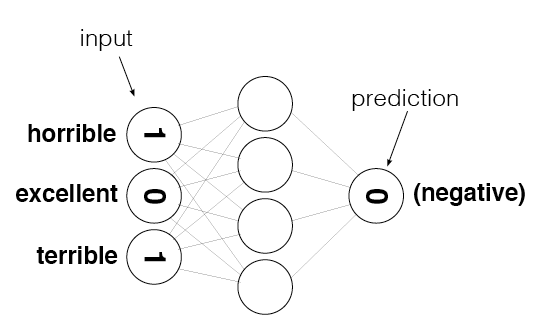

In [44]:
from IPython.display import Image

review = "This was a horrible, terrible movie."

Image(filename='sentiment_network.png')

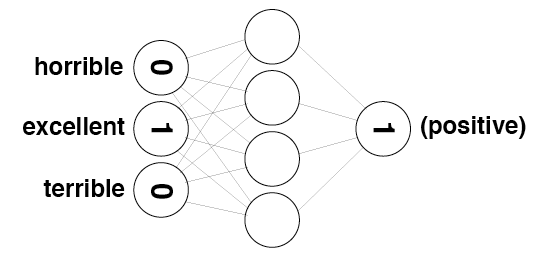

In [20]:
review = "The movie was excellent"

Image(filename='sentiment_network_pos.png')

# Project 2: Creating the Input/Output Data<a id='project_2'></a>

**TODO:** Create a [set](https://docs.python.org/3/tutorial/datastructures.html#sets) named `vocab` that contains every word in the vocabulary.

In [21]:
# TODO: Create set named "vocab" containing all of the words from all of the reviews

vocab = set()

for words in total_counts:
    vocab.add(words)

Run the following cell to check your vocabulary size. If everything worked correctly, it should print **74074**

In [22]:
vocab_size = len(vocab)
print(vocab_size)

74074


Take a look at the following image. It represents the layers of the neural network you'll be building throughout this notebook. `layer_0` is the input layer, `layer_1` is a hidden layer, and `layer_2` is the output layer.

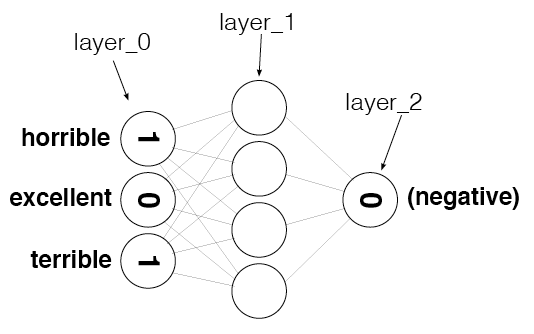

In [23]:
from IPython.display import Image
Image(filename='sentiment_network_2.png')

**TODO:** Create a numpy array called `layer_0` and initialize it to all zeros. You will find the [zeros](https://docs.scipy.org/doc/numpy/reference/generated/numpy.zeros.html) function particularly helpful here. Be sure you create `layer_0` as a 2-dimensional matrix with 1 row and `vocab_size` columns. 

In [24]:
# TODO: Create layer_0 matrix with dimensions 1 by vocab_size, initially filled with zeros
layer_0 = np.zeros((1,vocab_size))

Run the following cell. It should display `(1, 74074)`

In [25]:
layer_0.shape

(1, 74074)

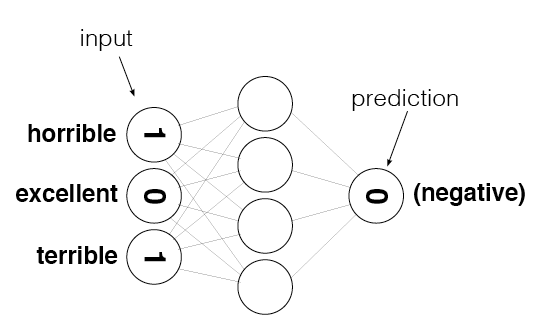

In [26]:
from IPython.display import Image
Image(filename='sentiment_network.png')

`layer_0` contains one entry for every word in the vocabulary, as shown in the above image. We need to make sure we know the index of each word, so run the following cell to create a lookup table that stores the index of every word.

In [27]:
# Create a dictionary of words in the vocabulary mapped to index positions
# (to be used in layer_0)
word2index = {}
for i,word in enumerate(vocab):
    word2index[word] = i
    
# display the map of words to indices
word2index

{'': 0,
 'choppy': 1,
 'anal': 2,
 'batter': 3,
 'circumcision': 4,
 'willens': 5,
 'sidestepped': 6,
 'soon': 7,
 'quack': 8,
 'greaser': 9,
 'decoration': 10,
 'keepers': 11,
 'eyeglasses': 12,
 'santacruz': 13,
 'trotting': 14,
 'emphasizing': 15,
 'sharpe': 16,
 'joust': 17,
 'critiquing': 18,
 'purloin': 19,
 'organised': 20,
 'mimetic': 21,
 'slashers': 22,
 'sooooooooo': 23,
 'kindest': 24,
 'archetypes': 25,
 'irby': 26,
 'nihilism': 27,
 'cropping': 28,
 'devoured': 29,
 'breast': 30,
 'stoneface': 31,
 'planetary': 32,
 'forerunners': 33,
 'maxx': 34,
 'cundy': 35,
 'newspaperman': 36,
 'symbiotic': 37,
 'disown': 38,
 'changin': 39,
 'actio': 40,
 'advisory': 41,
 'bergerac': 42,
 'luther': 43,
 'vulkin': 44,
 'amalgamated': 45,
 'warners': 46,
 'leicester': 47,
 'tersteeghe': 48,
 'driveway': 49,
 'tensdoorp': 50,
 'whomevers': 51,
 'zara': 52,
 'trainwreck': 53,
 'correspond': 54,
 'binysh': 55,
 'contemplative': 56,
 'ornament': 57,
 'cytown': 58,
 'novelists': 59,
 'yess

**TODO:**  Complete the implementation of `update_input_layer`. It should count 
          how many times each word is used in the given review, and then store
          those counts at the appropriate indices inside `layer_0`.

In [28]:
def update_input_layer(review):
    """ Modify the global layer_0 to represent the vector form of review.
    The element at a given index of layer_0 should represent
    how many times the given word occurs in the review.
    Args:
        review(string) - the string of the review
    Returns:
        None
    """
    global layer_0
    # clear out previous state by resetting the layer to be all 0s
    layer_0 *= 0
    
    list_of_words = review.split()
    
    for word in set(list_of_words):
        count = list_of_words.count(word)
        index_word = word2index[word]
        layer_0[0][index_word] = count
    
    
    
    # TODO: count how many times each word is used in the given review and store the results in layer_0 

In [29]:
reviews[0]

'bromwell high is a cartoon comedy . it ran at the same time as some other programs about school life  such as  teachers  . my   years in the teaching profession lead me to believe that bromwell high  s satire is much closer to reality than is  teachers  . the scramble to survive financially  the insightful students who can see right through their pathetic teachers  pomp  the pettiness of the whole situation  all remind me of the schools i knew and their students . when i saw the episode in which a student repeatedly tried to burn down the school  i immediately recalled . . . . . . . . . at . . . . . . . . . . high . a classic line inspector i  m here to sack one of your teachers . student welcome to bromwell high . i expect that many adults of my age think that bromwell high is far fetched . what a pity that it isn  t   '

Run the following cell to test updating the input layer with the first review. The indices assigned may not be the same as in the solution, but hopefully you'll see some non-zero values in `layer_0`.  

In [30]:
update_input_layer(reviews[0])
layer_0

array([[ 0.,  0.,  0., ...,  0.,  0.,  0.]])

**TODO:** Complete the implementation of `get_target_for_labels`. It should return `0` or `1`, 
          depending on whether the given label is `NEGATIVE` or `POSITIVE`, respectively.

In [31]:
def get_target_for_label(label):
    """Convert a label to `0` or `1`.
    Args:
        label(string) - Either "POSITIVE" or "NEGATIVE".
    Returns:
        `0` or `1`.
    """
    if label =='POSITIVE':
        return 1
    else:
        return 0
    # TODO: Your code here

Run the following two cells. They should print out`'POSITIVE'` and `1`, respectively.

In [32]:
labels[0]

'POSITIVE'

In [33]:
get_target_for_label(labels[0])

1

Run the following two cells. They should print out `'NEGATIVE'` and `0`, respectively.

In [34]:
labels[1]

'NEGATIVE'

In [35]:
get_target_for_label(labels[1])

0

# End of Project 2. 
## Watch the next video to see Andrew's solution, then continue on to the next lesson.

# Project 3: Building a Neural Network<a id='project_3'></a>

**TODO:** We've included the framework of a class called `SentimentNetork`. Implement all of the items marked `TODO` in the code. These include doing the following:
- Create a basic neural network much like the networks you've seen in earlier lessons and in Project 1, with an input layer, a hidden layer, and an output layer. 
- Do **not** add a non-linearity in the hidden layer. That is, do not use an activation function when calculating the hidden layer outputs.
- Re-use the code from earlier in this notebook to create the training data (see `TODO`s in the code)
- Implement the `pre_process_data` function to create the vocabulary for our training data generating functions
- Ensure `train` trains over the entire corpus

### Where to Get Help if You Need it
- Re-watch earlier Udacity lectures
- Chapters 3-5 - [Grokking Deep Learning](https://www.manning.com/books/grokking-deep-learning) - (Check inside your classroom for a discount code)

In [82]:
import time
import sys
import numpy as np

# Encapsulate our neural network in a class
class SentimentNetwork:
    def __init__(self, reviews, labels, hidden_nodes = 20, learning_rate = 0.1):
        """Create a SentimenNetwork with the given settings
        Args:
            reviews(list) - List of reviews used for training
            labels(list) - List of POSITIVE/NEGATIVE labels associated with the given reviews
            hidden_nodes(int) - Number of nodes to create in the hidden layer
            learning_rate(float) - Learning rate to use while training
        
        """
        # Assign a seed to our random number generator to ensure we get
        # reproducable results during development 
        np.random.seed(1)

        # process the reviews and their associated labels so that everything
        # is ready for training
        self.pre_process_data(reviews, labels)
        
        # Build the network to have the number of hidden nodes and the learning rate that
        # were passed into this initializer. Make the same number of input nodes as
        # there are vocabulary words and create a single output node.
        self.init_network(len(self.review_vocab),hidden_nodes, 1, learning_rate)

    def pre_process_data(self, reviews, labels):
        
        review_vocab = set()
        # TODO: populate review_vocab with all of the words in the given reviews
        #       Remember to split reviews into individual words 
        #       using "split(' ')" instead of "split()".
        
        for review in reviews:
            list_of_words = review.split(" ")
            for word in list_of_words:
                review_vocab.add(word)
        
        
        # Convert the vocabulary set to a list so we can access words via indices
        self.review_vocab = list(review_vocab)
    
        label_vocab = set()
        # TODO: populate label_vocab with all of the words in the given labels.
        #       There is no need to split the labels because each one is a single word.
        for label in labels:
            label_vocab.add(label)
        # Convert the label vocabulary set to a list so we can access labels via indices
        self.label_vocab = list(label_vocab)
        
        # Store the sizes of the review and label vocabularies.
        self.review_vocab_size = len(self.review_vocab)
        self.label_vocab_size = len(self.label_vocab)
        
        # Create a dictionary of words in the vocabulary mapped to index positions
        self.word2index = {}
        # TODO: populate self.word2index with indices for all the words in self.review_vocab
        #       like you saw earlier in the notebook
        for i,word in enumerate(self.review_vocab):
            self.word2index[word] = i
        # Create a dictionary of labels mapped to index positions
        self.label2index = {}
        
        for j,label in enumerate(self.label_vocab):
            self.label2index[label] = j
        # TODO: do the same thing you did for self.word2index and self.review_vocab, 
        #       but for self.label2index and self.label_vocab instead
         
        
    def init_network(self, input_nodes, hidden_nodes, output_nodes, learning_rate):
        # Store the number of nodes in input, hidden, and output layers.
        self.input_nodes = input_nodes
        self.hidden_nodes = hidden_nodes
        self.output_nodes = output_nodes

        # Store the learning rate
        self.learning_rate = learning_rate

        # Initialize weights
        
        # TODO: initialize self.weights_0_1 as a matrix of zeros. These are the weights between
        #       the input layer and the hidden layer.
        self.weights_0_1 = np.zeros((self.input_nodes,self.hidden_nodes))
        
        # TODO: initialize self.weights_1_2 as a matrix of random values. 
        #       These are the weights between the hidden layer and the output layer.
        self.weights_1_2 = np.random.rand(self.hidden_nodes,self.output_nodes)
        
        # TODO: Create the input layer, a two-dimensional matrix with shape 
        #       1 x input_nodes, with all values initialized to zero
        self.layer_0 = np.zeros((1,input_nodes))
    
        
    def update_input_layer(self,review):
        # TODO: You can copy most of the code you wrote for update_input_layer 
        #       earlier in this notebook. 
        #
        #       However, MAKE SURE YOU CHANGE ALL VARIABLES TO REFERENCE
        #       THE VERSIONS STORED IN THIS OBJECT, NOT THE GLOBAL OBJECTS.
        #       For example, replace "layer_0 *= 0" with "self.layer_0 *= 0"
    
    # clear out previous state by resetting the layer to be all 0s
        self.layer_0 *= 0
         
        list_of_words = review.split()
        
      
               

        
        for word in set(list_of_words):           
            if(word in self.word2index.keys()):
                count = list_of_words.count(word)
                index_word = self.word2index[word]
                self.layer_0[0][index_word] = count

        
        
                
    def get_target_for_label(self,label):
        # TODO: Copy the code you wrote for get_target_for_label 
        #       earlier in this notebook. 
        if label =='POSITIVE':
            return 1
        else:
            return 0

        
    def sigmoid(self,x):
        # TODO: Return the result of calculating the sigmoid activation function
        #       shown in the lectures
        z = 1/(1 + np.exp(-x)) 
        return z
    
    def sigmoid_output_2_derivative(self,output):
        # TODO: Return the derivative of the sigmoid activation function, 
        #       where "output" is the original output from the sigmoid fucntion 
        return output * (1.0 - output)

    def train(self, training_reviews, training_labels):
        
        # make sure out we have a matching number of reviews and labels
        assert(len(training_reviews) == len(training_labels))
        
        # Keep track of correct predictions to display accuracy during training 
        correct_so_far = 0
        
        # Remember when we started for printing time statistics
        start = time.time()

        # loop through all the given reviews and run a forward and backward pass,
        # updating weights for every item
        for i in range(len(training_reviews)):
            
            # TODO: Get the next review and its correct label
            review = training_reviews[i]
            label = training_labels[i]
            
            self.update_input_layer(review)
            out = self.get_target_for_label(label)
            
            layer_1 = self.layer_0.dot(self.weights_0_1)
            
            layer_2 = self.sigmoid(layer_1.dot(self.weights_1_2))
            
            layer_2_error = out - layer_2            
            layer_2_delta = layer_2_error*self.sigmoid_output_2_derivative(layer_2)
            
            
            layer_1_error = layer_2_delta.dot(self.weights_1_2.T)
            layer_1_delta = layer_1_error
            
            self.weights_1_2 -= layer_1.T.dot(layer_2_delta)*self.learning_rate
            self.weights_0_1 -= self.layer_0.T.dot(layer_1_delta)*self.learning_rate 
            
            if (np.abs(layer_2_error) < 0.5):
                correct_so_far +=1
            
            # TODO: Implement the forward pass through the network. 
            #       That means use the given review to update the input layer, 
            #       then calculate values for the hidden layer,
            #       and finally calculate the output layer.
            # 
            #       Do not use an activation function for the hidden layer,
            #       but use the sigmoid activation function for the output layer.
            
            # TODO: Implement the back propagation pass here. 
            #       That means calculate the error for the forward pass's prediction
            #       and update the weights in the network according to their
            #       contributions toward the error, as calculated via the
            #       gradient descent and back propagation algorithms you 
            #       learned in class.
            
            # TODO: Keep track of correct predictions. To determine if the prediction was
            #       correct, check that the absolute value of the output error 
            #       is less than 0.5. If so, add one to the correct_so_far count.
            
            # For debug purposes, print out our prediction accuracy and speed 
            # throughout the training process. 

            elapsed_time = float(time.time() - start)
            reviews_per_second = i / elapsed_time if elapsed_time > 0 else 0
            
            sys.stdout.write("\rProgress:" + str(100 * i/float(len(training_reviews)))[:4] \
                             + "% Speed(reviews/sec):" + str(reviews_per_second)[0:5] \
                             + " #Correct:" + str(correct_so_far) + " #Trained:" + str(i+1) \
                             + " Training Accuracy:" + str(correct_so_far * 100 / float(i+1))[:4] + "%")
            if(i % 2500 == 0):
                print("")
    
    def test(self, testing_reviews, testing_labels):
        """
        Attempts to predict the labels for the given testing_reviews,
        and uses the test_labels to calculate the accuracy of those predictions.
        """
        
        # keep track of how many correct predictions we make
        correct = 0

        # we'll time how many predictions per second we make
        start = time.time()

        # Loop through each of the given reviews and call run to predict
        # its label. 
        for i in range(len(testing_reviews)):
            pred = self.run(testing_reviews[i])
            if(pred == testing_labels[i]):
                correct += 1
            
            # For debug purposes, print out our prediction accuracy and speed 
            # throughout the prediction process. 

            elapsed_time = float(time.time() - start)
            reviews_per_second = i / elapsed_time if elapsed_time > 0 else 0
            
            sys.stdout.write("\rProgress:" + str(100 * i/float(len(testing_reviews)))[:4] \
                             + "% Speed(reviews/sec):" + str(reviews_per_second)[0:5] \
                             + " #Correct:" + str(correct) + " #Tested:" + str(i+1) \
                             + " Testing Accuracy:" + str(correct * 100 / float(i+1))[:4] + "%")
    
    def run(self, review):
        """
        Returns a POSITIVE or NEGATIVE prediction for the given review.
        """
        
        self.update_input_layer(review.lower())
        
        layer_1 = self.layer_0.dot(self.weights_0_1)
        
        layer_2 =  self.sigmoid(layer_1.dot(self.weights_1_2))
        
        if layer_2[0] > 0.5:
            return "POSITIVE"
        
        else:
            return "NEGATIVE"
        # TODO: Run a forward pass through the network, like you did in the
        #       "train" function. That means use the given review to 
        #       update the input layer, then calculate values for the hidden layer,
        #       and finally calculate the output layer.
        #
        #       Note: The review passed into this function for prediction 
        #             might come from anywhere, so you should convert it 
        #             to lower case prior to using it.
        
        # TODO: The output layer should now contain a prediction. 
        #       Return `POSITIVE` for predictions greater-than-or-equal-to `0.5`, 
        #       and `NEGATIVE` otherwise.
        pass


Run the following cell to create a `SentimentNetwork` that will train on all but the last 1000 reviews (we're saving those for testing). Here we use a learning rate of `0.1`.

In [83]:
mlp = SentimentNetwork(reviews[:-1000],labels[:-1000], learning_rate=0.01)

Run the following cell to test the network's performance against the last 1000 reviews (the ones we held out from our training set). 

**We have not trained the model yet, so the results should be about 50% as it will just be guessing and there are only two possible values to choose from.**

In [76]:
mlp.test(reviews[-1000:],labels[-1000:])

Progress:99.9% Speed(reviews/sec):540.5 #Correct:500 #Tested:1000 Testing Accuracy:50.0%

Run the following cell to actually train the network. During training, it will display the model's accuracy repeatedly as it trains so you can see how well it's doing.

In [84]:
mlp.train(reviews[:-1000],labels[:-1000])

Progress:0.0% Speed(reviews/sec):0.0 #Correct:0 #Trained:1 Training Accuracy:0.0%
Progress:10.4% Speed(reviews/sec):45.87 #Correct:1250 #Trained:2501 Training Accuracy:49.9%
Progress:20.8% Speed(reviews/sec):45.46 #Correct:2500 #Trained:5001 Training Accuracy:49.9%
Progress:31.2% Speed(reviews/sec):45.22 #Correct:3750 #Trained:7501 Training Accuracy:49.9%
Progress:41.6% Speed(reviews/sec):45.22 #Correct:5000 #Trained:10001 Training Accuracy:49.9%
Progress:52.0% Speed(reviews/sec):45.10 #Correct:6250 #Trained:12501 Training Accuracy:49.9%
Progress:62.5% Speed(reviews/sec):45.14 #Correct:7500 #Trained:15001 Training Accuracy:49.9%
Progress:72.9% Speed(reviews/sec):45.23 #Correct:8750 #Trained:17501 Training Accuracy:49.9%
Progress:83.3% Speed(reviews/sec):45.21 #Correct:10000 #Trained:20001 Training Accuracy:49.9%
Progress:93.7% Speed(reviews/sec):45.20 #Correct:11250 #Trained:22501 Training Accuracy:49.9%
Progress:99.9% Speed(reviews/sec):45.16 #Correct:12000 #Trained:24000 Training Acc

That most likely didn't train very well. Part of the reason may be because the learning rate is too high. Run the following cell to recreate the network with a smaller learning rate, `0.01`, and then train the new network.

In [ ]:
mlp = SentimentNetwork(reviews[:-1000],labels[:-1000], learning_rate=0.01)
mlp.train(reviews[:-1000],labels[:-1000])

That probably wasn't much different. Run the following cell to recreate the network one more time with an even smaller learning rate, `0.001`, and then train the new network.

In [ ]:
mlp = SentimentNetwork(reviews[:-1000],labels[:-1000], learning_rate=0.001)
mlp.train(reviews[:-1000],labels[:-1000])

With a learning rate of `0.001`, the network should finall have started to improve during training. It's still not very good, but it shows that this solution has potential. We will improve it in the next lesson.

# End of Project 3. 
## Watch the next video to see Andrew's solution, then continue on to the next lesson.

# Understanding Neural Noise<a id='lesson_4'></a>

The following cells include includes the code Andrew shows in the next video. We've included it here so you can run the cells along with the video without having to type in everything.

In [ ]:
from IPython.display import Image
Image(filename='sentiment_network.png')

In [85]:
def update_input_layer(review):
    
    global layer_0
    
    # clear out previous state, reset the layer to be all 0s
    layer_0 *= 0
    for word in review.split(" "):
        layer_0[0][word2index[word]] += 1

update_input_layer(reviews[0])

In [86]:
layer_0

array([[ 18.,   0.,   0., ...,   0.,   0.,   0.]])

In [87]:
review_counter = Counter()

In [88]:
for word in reviews[0].split(" "):
    review_counter[word] += 1

In [89]:
review_counter.most_common()

[('.', 27),
 ('', 18),
 ('the', 9),
 ('to', 6),
 ('high', 5),
 ('i', 5),
 ('bromwell', 4),
 ('is', 4),
 ('a', 4),
 ('teachers', 4),
 ('that', 4),
 ('of', 4),
 ('it', 2),
 ('at', 2),
 ('as', 2),
 ('school', 2),
 ('my', 2),
 ('in', 2),
 ('me', 2),
 ('students', 2),
 ('their', 2),
 ('student', 2),
 ('cartoon', 1),
 ('comedy', 1),
 ('ran', 1),
 ('same', 1),
 ('time', 1),
 ('some', 1),
 ('other', 1),
 ('programs', 1),
 ('about', 1),
 ('life', 1),
 ('such', 1),
 ('years', 1),
 ('teaching', 1),
 ('profession', 1),
 ('lead', 1),
 ('believe', 1),
 ('s', 1),
 ('satire', 1),
 ('much', 1),
 ('closer', 1),
 ('reality', 1),
 ('than', 1),
 ('scramble', 1),
 ('survive', 1),
 ('financially', 1),
 ('insightful', 1),
 ('who', 1),
 ('can', 1),
 ('see', 1),
 ('right', 1),
 ('through', 1),
 ('pathetic', 1),
 ('pomp', 1),
 ('pettiness', 1),
 ('whole', 1),
 ('situation', 1),
 ('all', 1),
 ('remind', 1),
 ('schools', 1),
 ('knew', 1),
 ('and', 1),
 ('when', 1),
 ('saw', 1),
 ('episode', 1),
 ('which', 1),
 ('r

# Project 4: Reducing Noise in Our Input Data<a id='project_4'></a>

**TODO:** Attempt to reduce the noise in the input data like Andrew did in the previous video. Specifically, do the following:
* Copy the `SentimentNetwork` class you created earlier into the following cell.
* Modify `update_input_layer` so it does not count how many times each word is used, but rather just stores whether or not a word was used. 

In [103]:
# TODO: -Copy the SentimentNetwork class from Projet 3 lesson
#       -Modify it to reduce noise, like in the video 

import time
import sys
import numpy as np

# Encapsulate our neural network in a class
class SentimentNetwork:
    def __init__(self, reviews, labels, hidden_nodes = 10, learning_rate = 0.1):
        """Create a SentimenNetwork with the given settings
        Args:
            reviews(list) - List of reviews used for training
            labels(list) - List of POSITIVE/NEGATIVE labels associated with the given reviews
            hidden_nodes(int) - Number of nodes to create in the hidden layer
            learning_rate(float) - Learning rate to use while training
        
        """
        # Assign a seed to our random number generator to ensure we get
        # reproducable results during development 
        np.random.seed(1)

        # process the reviews and their associated labels so that everything
        # is ready for training
        self.pre_process_data(reviews, labels)
        
        # Build the network to have the number of hidden nodes and the learning rate that
        # were passed into this initializer. Make the same number of input nodes as
        # there are vocabulary words and create a single output node.
        self.init_network(len(self.review_vocab),hidden_nodes, 1, learning_rate)

    def pre_process_data(self, reviews, labels):
        
        review_vocab = set()
        # TODO: populate review_vocab with all of the words in the given reviews
        #       Remember to split reviews into individual words 
        #       using "split(' ')" instead of "split()".
        
        for review in reviews:
            list_of_words = review.split(" ")
            for word in list_of_words:
                review_vocab.add(word)
        
        
        # Convert the vocabulary set to a list so we can access words via indices
        self.review_vocab = list(review_vocab)
    
        label_vocab = set()
        # TODO: populate label_vocab with all of the words in the given labels.
        #       There is no need to split the labels because each one is a single word.
        for label in labels:
            label_vocab.add(label)
        # Convert the label vocabulary set to a list so we can access labels via indices
        self.label_vocab = list(label_vocab)
        
        # Store the sizes of the review and label vocabularies.
        self.review_vocab_size = len(self.review_vocab)
        self.label_vocab_size = len(self.label_vocab)
        
        # Create a dictionary of words in the vocabulary mapped to index positions
        self.word2index = {}
        # TODO: populate self.word2index with indices for all the words in self.review_vocab
        #       like you saw earlier in the notebook
        for i,word in enumerate(self.review_vocab):
            self.word2index[word] = i
        # Create a dictionary of labels mapped to index positions
        self.label2index = {}
        
        for j,label in enumerate(self.label_vocab):
            self.label2index[label] = j
        # TODO: do the same thing you did for self.word2index and self.review_vocab, 
        #       but for self.label2index and self.label_vocab instead
         
        
    def init_network(self, input_nodes, hidden_nodes, output_nodes, learning_rate):
        # Store the number of nodes in input, hidden, and output layers.
        self.input_nodes = input_nodes
        self.hidden_nodes = hidden_nodes
        self.output_nodes = output_nodes

        # Store the learning rate
        self.learning_rate = learning_rate

        # Initialize weights
        
        # TODO: initialize self.weights_0_1 as a matrix of zeros. These are the weights between
        #       the input layer and the hidden layer.
        self.weights_0_1 = np.zeros((self.input_nodes,self.hidden_nodes))
        
        # TODO: initialize self.weights_1_2 as a matrix of random values. 
        #       These are the weights between the hidden layer and the output layer.
        self.weights_1_2 = np.random.rand(self.hidden_nodes,self.output_nodes)
        
        # TODO: Create the input layer, a two-dimensional matrix with shape 
        #       1 x input_nodes, with all values initialized to zero
        self.layer_0 = np.zeros((1,input_nodes))
    
        
    def update_input_layer(self,review):

        # clear out previous state, reset the layer to be all 0s
        self.layer_0 *= 0
        
        for word in review.split(" "):
            # NOTE: This if-check was not in the version of this method created in Project 2,
            #       and it appears in Andrew's Project 3 solution without explanation. 
            #       It simply ensures the word is actually a key in word2index before
            #       accessing it, which is important because accessing an invalid key
            #       with raise an exception in Python. This allows us to ignore unknown
            #       words encountered in new reviews.
            if(word in self.word2index.keys()):
                ## New for Project 4: changed to set to 1 instead of add 1
                self.layer_0[0][self.word2index[word]] = 1

        
        
                
    def get_target_for_label(self,label):
        # TODO: Copy the code you wrote for get_target_for_label 
        #       earlier in this notebook. 
        if label =='POSITIVE':
            return 1
        else:
            return 0

        
    def sigmoid(self,x):
        # TODO: Return the result of calculating the sigmoid activation function
        #       shown in the lectures
        z = 1/(1 + np.exp(-x)) 
        return z
    
    def sigmoid_output_2_derivative(self,output):
        # TODO: Return the derivative of the sigmoid activation function, 
        #       where "output" is the original output from the sigmoid fucntion 
        return output * (1.0 - output)

    def train(self, training_reviews, training_labels):
        
        # make sure out we have a matching number of reviews and labels
        assert(len(training_reviews) == len(training_labels))
        
        # Keep track of correct predictions to display accuracy during training 
        correct_so_far = 0
        
        # Remember when we started for printing time statistics
        start = time.time()

        # loop through all the given reviews and run a forward and backward pass,
        # updating weights for every item
        for i in range(len(training_reviews)):
            
            # TODO: Get the next review and its correct label
            review = training_reviews[i]
            label = training_labels[i]
            
            self.update_input_layer(review)
            out = self.get_target_for_label(label)
            
            layer_1 = self.layer_0.dot(self.weights_0_1)
            
            layer_2 = self.sigmoid(layer_1.dot(self.weights_1_2))
            
            layer_2_error = layer_2 - out            
            layer_2_delta = layer_2_error*self.sigmoid_output_2_derivative(layer_2)
            
            
            layer_1_error = layer_2_delta.dot(self.weights_1_2.T)
            layer_1_delta = layer_1_error
            
            self.weights_1_2 -= layer_1.T.dot(layer_2_delta)*self.learning_rate
            self.weights_0_1 -= self.layer_0.T.dot(layer_1_delta)*self.learning_rate 
            
            if (np.abs(layer_2_error) < 0.5):
                correct_so_far +=1
            
            # TODO: Implement the forward pass through the network. 
            #       That means use the given review to update the input layer, 
            #       then calculate values for the hidden layer,
            #       and finally calculate the output layer.
            # 
            #       Do not use an activation function for the hidden layer,
            #       but use the sigmoid activation function for the output layer.
            
            # TODO: Implement the back propagation pass here. 
            #       That means calculate the error for the forward pass's prediction
            #       and update the weights in the network according to their
            #       contributions toward the error, as calculated via the
            #       gradient descent and back propagation algorithms you 
            #       learned in class.
            
            # TODO: Keep track of correct predictions. To determine if the prediction was
            #       correct, check that the absolute value of the output error 
            #       is less than 0.5. If so, add one to the correct_so_far count.
            
            # For debug purposes, print out our prediction accuracy and speed 
            # throughout the training process. 

            elapsed_time = float(time.time() - start)
            reviews_per_second = i / elapsed_time if elapsed_time > 0 else 0
            
            sys.stdout.write("\rProgress:" + str(100 * i/float(len(training_reviews)))[:4] \
                             + "% Speed(reviews/sec):" + str(reviews_per_second)[0:5] \
                             + " #Correct:" + str(correct_so_far) + " #Trained:" + str(i+1) \
                             + " Training Accuracy:" + str(correct_so_far * 100 / float(i+1))[:4] + "%")
            if(i % 2500 == 0):
                print("")
    
    def test(self, testing_reviews, testing_labels):
        """
        Attempts to predict the labels for the given testing_reviews,
        and uses the test_labels to calculate the accuracy of those predictions.
        """
        
        # keep track of how many correct predictions we make
        correct = 0

        # we'll time how many predictions per second we make
        start = time.time()

        # Loop through each of the given reviews and call run to predict
        # its label. 
        for i in range(len(testing_reviews)):
            pred = self.run(testing_reviews[i])
            if(pred == testing_labels[i]):
                correct += 1
            
            # For debug purposes, print out our prediction accuracy and speed 
            # throughout the prediction process. 

            elapsed_time = float(time.time() - start)
            reviews_per_second = i / elapsed_time if elapsed_time > 0 else 0
            
            sys.stdout.write("\rProgress:" + str(100 * i/float(len(testing_reviews)))[:4] \
                             + "% Speed(reviews/sec):" + str(reviews_per_second)[0:5] \
                             + " #Correct:" + str(correct) + " #Tested:" + str(i+1) \
                             + " Testing Accuracy:" + str(correct * 100 / float(i+1))[:4] + "%")
    
    def run(self, review):
        """
        Returns a POSITIVE or NEGATIVE prediction for the given review.
        """
        
        self.update_input_layer(review.lower())
        
        layer_1 = self.layer_0.dot(self.weights_0_1)
        
        layer_2 =  self.sigmoid(layer_1.dot(self.weights_1_2))
        
        if layer_2[0] > 0.5:
            return "POSITIVE"
        
        else:
            return "NEGATIVE"
        # TODO: Run a forward pass through the network, like you did in the
        #       "train" function. That means use the given review to 
        #       update the input layer, then calculate values for the hidden layer,
        #       and finally calculate the output layer.
        #
        #       Note: The review passed into this function for prediction 
        #             might come from anywhere, so you should convert it 
        #             to lower case prior to using it.
        
        # TODO: The output layer should now contain a prediction. 
        #       Return `POSITIVE` for predictions greater-than-or-equal-to `0.5`, 
        #       and `NEGATIVE` otherwise.
        pass


Run the following cell to recreate the network and train it. Notice we've gone back to the higher learning rate of `0.1`.

In [104]:
mlp = SentimentNetwork(reviews[:-1000],labels[:-1000], learning_rate=0.1)
mlp.train(reviews[:-1000],labels[:-1000])

Progress:0.0% Speed(reviews/sec):0.0 #Correct:0 #Trained:1 Training Accuracy:0.0%
Progress:10.4% Speed(reviews/sec):259.9 #Correct:1948 #Trained:2501 Training Accuracy:77.8%
Progress:20.8% Speed(reviews/sec):264.2 #Correct:3993 #Trained:5001 Training Accuracy:79.8%
Progress:31.2% Speed(reviews/sec):263.7 #Correct:6120 #Trained:7501 Training Accuracy:81.5%
Progress:41.6% Speed(reviews/sec):261.4 #Correct:8277 #Trained:10001 Training Accuracy:82.7%
Progress:52.0% Speed(reviews/sec):259.4 #Correct:10438 #Trained:12501 Training Accuracy:83.4%
Progress:62.5% Speed(reviews/sec):259.5 #Correct:12579 #Trained:15001 Training Accuracy:83.8%
Progress:72.9% Speed(reviews/sec):259.4 #Correct:14693 #Trained:17501 Training Accuracy:83.9%
Progress:83.3% Speed(reviews/sec):260.1 #Correct:16867 #Trained:20001 Training Accuracy:84.3%
Progress:93.7% Speed(reviews/sec):259.5 #Correct:19054 #Trained:22501 Training Accuracy:84.6%
Progress:99.9% Speed(reviews/sec):260.0 #Correct:20374 #Trained:24000 Training 

That should have trained much better than the earlier attempts. It's still not wonderful, but it should have improved dramatically. Run the following cell to test your model with 1000 predictions.

In [105]:
mlp.test(reviews[-1000:],labels[-1000:])

Progress:21.1% Speed(reviews/sec):1039. #Correct:187 #Tested:212 Testing Accuracy:88.2%

Progress:42.8% Speed(reviews/sec):1051. #Correct:378 #Tested:429 Testing Accuracy:88.1%

Progress:64.0% Speed(reviews/sec):1047. #Correct:558 #Tested:641 Testing Accuracy:87.0%

Progress:85.3% Speed(reviews/sec):1046. #Correct:736 #Tested:854 Testing Accuracy:86.1%

Progress:99.9% Speed(reviews/sec):1055. #Correct:860 #Tested:1000 Testing Accuracy:86.0%

# End of Project 4. 
## Andrew's solution was actually in the previous video, so rewatch that video if you had any problems with that project. Then continue on to the next lesson.
# Analyzing Inefficiencies in our Network<a id='lesson_5'></a>
The following cells include the code Andrew shows in the next video. We've included it here so you can run the cells along with the video without having to type in everything.

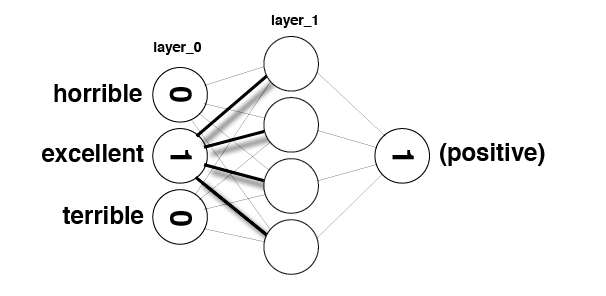

In [106]:
Image(filename='sentiment_network_sparse.png')

In [14]:
layer_0 = np.zeros((10,1))

In [17]:
layer_1 = np.zeros((10,1))

In [18]:
layer_0.dot(layer_1)

ValueError: shapes (10,1) and (10,1) not aligned: 1 (dim 1) != 10 (dim 0)

In [109]:
layer_0[4] = 1
layer_0[9] = 1

In [113]:
layer_0.shape

(10,)

In [117]:
weights_0_1 = np.random.randn(10,5)
weights_0_1.shape

(10, 5)

In [13]:
layer_0.dot(weights_0_1)

NameError: name 'layer_0' is not defined

In [118]:
weights_0_1.T.dot(layer_0)

array([ 0.91830369,  1.23146628,  0.82367326, -0.33290067, -0.05294571])

In [114]:
layer_0.dot(weights_0_1).shape

(5,)

In [ ]:
indices = [4,9]

In [ ]:
layer_1 = np.zeros(5)

In [ ]:
for index in indices:
    layer_1 += (1 * weights_0_1[index])

In [27]:
layer_1 = np.zeros((1,3))

In [28]:
layer_1[0] -= [3,4,5]

-4.0

In [23]:
Image(filename='sentiment_network_sparse_2.png')

NameError: name 'Image' is not defined

In [ ]:
layer_1 = np.zeros(5)

In [ ]:
for index in indices:
    layer_1 += (weights_0_1[index])

In [ ]:
layer_1

# Project 5: Making our Network More Efficient<a id='project_5'></a>
**TODO:** Make the `SentimentNetwork` class more efficient by eliminating unnecessary multiplications and additions that occur during forward and backward propagation. To do that, you can do the following:
* Copy the `SentimentNetwork` class from the previous project into the following cell.
* Remove the `update_input_layer` function - you will not need it in this version.
* Modify `init_network`:
>* You no longer need a separate input layer, so remove any mention of `self.layer_0`
>* You will be dealing with the old hidden layer more directly, so create `self.layer_1`, a two-dimensional matrix with shape 1 x hidden_nodes, with all values initialized to zero
* Modify `train`:
>* Change the name of the input parameter `training_reviews` to `training_reviews_raw`. This will help with the next step.
>* At the beginning of the function, you'll want to preprocess your reviews to convert them to a list of indices (from `word2index`) that are actually used in the review. This is equivalent to what you saw in the video when Andrew set specific indices to 1. Your code should create a local `list` variable named `training_reviews` that should contain a `list` for each review in `training_reviews_raw`. Those lists should contain the indices for words found in the review.
>* Remove call to `update_input_layer`
>* Use `self`'s  `layer_1` instead of a local `layer_1` object.
>* In the forward pass, replace the code that updates `layer_1` with new logic that only adds the weights for the indices used in the review.
>* When updating `weights_0_1`, only update the individual weights that were used in the forward pass.
* Modify `run`:
>* Remove call to `update_input_layer` 
>* Use `self`'s  `layer_1` instead of a local `layer_1` object.
>* Much like you did in `train`, you will need to pre-process the `review` so you can work with word indices, then update `layer_1` by adding weights for the indices used in the review.

In [10]:
import time
import sys
import numpy as np

# Encapsulate our neural network in a class
class SentimentNetwork:
    def __init__(self, reviews,labels,hidden_nodes = 10, learning_rate = 0.1):
        """Create a SentimenNetwork with the given settings
        Args:
            reviews(list) - List of reviews used for training
            labels(list) - List of POSITIVE/NEGATIVE labels associated with the given reviews
            hidden_nodes(int) - Number of nodes to create in the hidden layer
            learning_rate(float) - Learning rate to use while training
        
        """
        # Assign a seed to our random number generator to ensure we get
        # reproducable results during development 
        np.random.seed(1)

        # process the reviews and their associated labels so that everything
        # is ready for training
        self.pre_process_data(reviews, labels)
        
        # Build the network to have the number of hidden nodes and the learning rate that
        # were passed into this initializer. Make the same number of input nodes as
        # there are vocabulary words and create a single output node.
        self.init_network(len(self.review_vocab),hidden_nodes, 1, learning_rate)

    def pre_process_data(self, reviews, labels):
        
        # populate review_vocab with all of the words in the given reviews
        review_vocab = set()
        for review in reviews:
            for word in review.split(" "):
                review_vocab.add(word)

        # Convert the vocabulary set to a list so we can access words via indices
        self.review_vocab = list(review_vocab)
        
        # populate label_vocab with all of the words in the given labels.
        label_vocab = set()
        for label in labels:
            label_vocab.add(label)
        
        # Convert the label vocabulary set to a list so we can access labels via indices
        self.label_vocab = list(label_vocab)
        
        # Store the sizes of the review and label vocabularies.
        self.review_vocab_size = len(self.review_vocab)
        self.label_vocab_size = len(self.label_vocab)
        
        # Create a dictionary of words in the vocabulary mapped to index positions
        self.word2index = {}
        for i, word in enumerate(self.review_vocab):
            self.word2index[word] = i
        
        # Create a dictionary of labels mapped to index positions
        self.label2index = {}
        for i, label in enumerate(self.label_vocab):
            self.label2index[label] = i

    def init_network(self, input_nodes, hidden_nodes, output_nodes, learning_rate):
        # Set number of nodes in input, hidden and output layers.
        self.input_nodes = input_nodes
        self.hidden_nodes = hidden_nodes
        self.output_nodes = output_nodes

        # Store the learning rate
        self.learning_rate = learning_rate

        # Initialize weights

        # These are the weights between the input layer and the hidden layer.
        self.weights_0_1 = np.zeros((self.input_nodes,self.hidden_nodes))
        print("weights_0_1_shape",self.weights_0_1.shape)
        # These are the weights between the hidden layer and the output layer.
        self.weights_1_2 = np.random.normal(0.0, self.output_nodes**-0.5, 
                                                (self.hidden_nodes, self.output_nodes))
        print("weights_1_2_shape",self.weights_1_2.shape)
        ## New for Project 5: Removed self.layer_0; added self.layer_1
        # The input layer, a two-dimensional matrix with shape 1 x hidden_nodes
        self.layer_1 = np.zeros((1,hidden_nodes))
        print("layer1_weights", self.layer_1)
    
    ## New for Project 5: Removed update_input_layer function
    
    def get_target_for_label(self,label):
        if(label == 'POSITIVE'):
            return 1
        else:
            return 0
        
    def sigmoid(self,x):
        return 1 / (1 + np.exp(-x))
    
    def sigmoid_output_2_derivative(self,output):
        return output * (1 - output)
    
    ## New for Project 5: changed name of first parameter form 'training_reviews' 
    #                     to 'training_reviews_raw'
    def train(self, training_reviews_raw, training_labels):

        ## New for Project 5: pre-process training reviews so we can deal 
        #                     directly with the indices of non-zero inputs
        training_reviews = list()
        for review in training_reviews_raw:
            indices = set()
            for word in review.split(" "):
                if(word in self.word2index.keys()):
                    indices.add(self.word2index[word])
            training_reviews.append(list(indices))

        # make sure out we have a matching number of reviews and labels
        assert(len(training_reviews) == len(training_labels))
        
        # Keep track of correct predictions to display accuracy during training 
        correct_so_far = 0

        # Remember when we started for printing time statistics
        start = time.time()
        
        # loop through all the given reviews and run a forward and backward pass,
        # updating weights for every item
        for i in range(len(training_reviews)):
            
            # Get the next review and its correct label
            review = training_reviews[i]
            label = training_labels[i]
            
            #### Implement the forward pass here ####
            ### Forward pass ###

            ## New for Project 5: Removed call to 'update_input_layer' function
            #                     because 'layer_0' is no longer used

            # Hidden layer
            ## New for Project 5: Add in only the weights for non-zero items
            self.layer_1 *= 0
            for index in review:
                self.layer_1 += self.weights_0_1[index]
            
            print("layer_1_transpose",self.layer_1.shape)
            # Output layer
            ## New for Project 5: changed to use 'self.layer_1' instead of 'local layer_1'
            layer_2 = self.sigmoid(self.layer_1.dot(self.weights_1_2))            
            
            #### Implement the backward pass here ####
            ### Backward pass ###

            # Output error
            
            layer_2_error = layer_2 - self.get_target_for_label(label) # Output layer error is the difference between desired target and actual output.
            layer_2_delta = layer_2_error * self.sigmoid_output_2_derivative(layer_2)
            print("layer_2_delta,", layer_2_delta.shape)
           
            # Backpropagated error
            layer_1_error = layer_2_delta.dot(self.weights_1_2.T) # errors propagated to the hidden layer
            layer_1_delta = layer_1_error # hidden layer gradients - no nonlinearity so it's the same as the error
            print("layer_1_delta,", layer_1_delta.shape)
            # Update the weights
            ## New for Project 5: changed to use 'self.layer_1' instead of local 'layer_1'
            self.weights_1_2 -= self.layer_1.T.dot(layer_2_delta) * self.learning_rate # update hidden-to-output weights with gradient descent step
            
            ## New for Project 5: Only update the weights that were used in the forward pass
            for index in review:
                self.weights_0_1[index] -= layer_1_delta[0] * self.learning_rate # update input-to-hidden weights with gradient descent step

            # Keep track of correct predictions.
            if(layer_2 >= 0.5 and label == 'POSITIVE'):
                correct_so_far += 1
            elif(layer_2 < 0.5 and label == 'NEGATIVE'):
                correct_so_far += 1
            
            # For debug purposes, print out our prediction accuracy and speed 
            # throughout the training process. 
            elapsed_time = float(time.time() - start)
            reviews_per_second = i / elapsed_time if elapsed_time > 0 else 0
            
            sys.stdout.write("\rProgress:" + str(100 * i/float(len(training_reviews)))[:4] \
                             + "% Speed(reviews/sec):" + str(reviews_per_second)[0:5] \
                             + " #Correct:" + str(correct_so_far) + " #Trained:" + str(i+1) \
                             + " Training Accuracy:" + str(correct_so_far * 100 / float(i+1))[:4] + "%")
            if(i % 2500 == 0):
                print("")
    
    def test(self, testing_reviews, testing_labels):
        """
        Attempts to predict the labels for the given testing_reviews,
        and uses the test_labels to calculate the accuracy of those predictions.
        """
        
        # keep track of how many correct predictions we make
        correct = 0

        # we'll time how many predictions per second we make
        start = time.time()

        # Loop through each of the given reviews and call run to predict
        # its label. 
        for i in range(len(testing_reviews)):
            pred = self.run(testing_reviews[i])
            if(pred == testing_labels[i]):
                correct += 1
            
            # For debug purposes, print out our prediction accuracy and speed 
            # throughout the prediction process. 

            elapsed_time = float(time.time() - start)
            reviews_per_second = i / elapsed_time if elapsed_time > 0 else 0
            
            sys.stdout.write("\rProgress:" + str(100 * i/float(len(testing_reviews)))[:4] \
                             + "% Speed(reviews/sec):" + str(reviews_per_second)[0:5] \
                             + " #Correct:" + str(correct) + " #Tested:" + str(i+1) \
                             + " Testing Accuracy:" + str(correct * 100 / float(i+1))[:4] + "%")
    
    def run(self, review):
        """
        Returns a POSITIVE or NEGATIVE prediction for the given review.
        """
        # Run a forward pass through the network, like in the "train" function.
        
        ## New for Project 5: Removed call to update_input_layer function
        #                     because layer_0 is no longer used

        # Hidden layer
        ## New for Project 5: Identify the indices used in the review and then add
        #                     just those weights to layer_1 
        self.layer_1 *= 0
        unique_indices = set()
        for word in review.lower().split(" "):
            if word in self.word2index.keys():
                unique_indices.add(self.word2index[word])
        for index in unique_indices:
            self.layer_1 += self.weights_0_1[index]
        
        # Output layer
        ## New for Project 5: changed to use self.layer_1 instead of local layer_1
        layer_2 = self.sigmoid(self.layer_1.dot(self.weights_1_2))
        
        # Return POSITIVE for values above greater-than-or-equal-to 0.5 in the output layer;
        # return NEGATIVE for other values
        if(layer_2[0] >= 0.5):
            return "POSITIVE"
        else:
            return "NEGATIVE"


Run the following cell to recreate the network and train it once again.

In [120]:
mlp = SentimentNetwork(reviews[:-1000],labels[:-1000], learning_rate=0.1)
mlp.train(reviews[:-1000],labels[:-1000])

Progress:0.0% Speed(reviews/sec):0.0 #Correct:1 #Trained:1 Training Accuracy:100.%
Progress:10.4% Speed(reviews/sec):1568. #Correct:1841 #Trained:2501 Training Accuracy:73.6%
Progress:20.8% Speed(reviews/sec):1425. #Correct:3805 #Trained:5001 Training Accuracy:76.0%
Progress:31.2% Speed(reviews/sec):1450. #Correct:5886 #Trained:7501 Training Accuracy:78.4%
Progress:41.6% Speed(reviews/sec):1473. #Correct:8023 #Trained:10001 Training Accuracy:80.2%
Progress:52.0% Speed(reviews/sec):1481. #Correct:10158 #Trained:12501 Training Accuracy:81.2%
Progress:62.5% Speed(reviews/sec):1487. #Correct:12291 #Trained:15001 Training Accuracy:81.9%
Progress:72.9% Speed(reviews/sec):1487. #Correct:14410 #Trained:17501 Training Accuracy:82.3%
Progress:83.3% Speed(reviews/sec):1486. #Correct:16585 #Trained:20001 Training Accuracy:82.9%
Progress:93.7% Speed(reviews/sec):1487. #Correct:18774 #Trained:22501 Training Accuracy:83.4%
Progress:99.9% Speed(reviews/sec):1488. #Correct:20104 #Trained:24000 Training

In [11]:
mlp = SentimentNetwork(reviews[:-1000],labels[:-1000], learning_rate=0.1)

weights_0_1_shape (72810, 10)
weights_1_2_shape (10, 1)
layer1_weights [[ 0.  0.  0.  0.  0.  0.  0.  0.  0.  0.]]


In [12]:
mlp.train(reviews[:10],labels[:10])

layer_1_transpose (10, 1)
layer_2_delta, (1, 1)
layer_1_delta, (1, 10)
Progress:0.0% Speed(reviews/sec):0.0 #Correct:1 #Trained:1 Training Accuracy:100.%
layer_1_transpose (10, 1)
layer_2_delta, (1, 1)
layer_1_delta, (1, 10)
Progress:10.0% Speed(reviews/sec):194.3 #Correct:1 #Trained:2 Training Accuracy:50.0%layer_1_transpose (10, 1)
layer_2_delta, (1, 1)
layer_1_delta, (1, 10)
Progress:20.0% Speed(reviews/sec):257.3 #Correct:2 #Trained:3 Training Accuracy:66.6%layer_1_transpose (10, 1)
layer_2_delta, (1, 1)
layer_1_delta, (1, 10)
Progress:30.0% Speed(reviews/sec):266.9 #Correct:2 #Trained:4 Training Accuracy:50.0%layer_1_transpose (10, 1)
layer_2_delta, (1, 1)
layer_1_delta, (1, 10)
Progress:40.0% Speed(reviews/sec):309.9 #Correct:3 #Trained:5 Training Accuracy:60.0%layer_1_transpose (10, 1)
layer_2_delta, (1, 1)
layer_1_delta, (1, 10)
Progress:50.0% Speed(reviews/sec):356.8 #Correct:3 #Trained:6 Training Accuracy:50.0%layer_1_transpose (10, 1)
layer_2_delta, (1, 1)
layer_1_delta, (1,

That should have trained much better than the earlier attempts. Run the following cell to test your model with 1000 predictions.

In [ ]:
mlp.test(reviews[-1000:],labels[-1000:])

# End of Project 5. 
## Watch the next video to see Andrew's solution, then continue on to the next lesson.
# Further Noise Reduction<a id='lesson_6'></a>

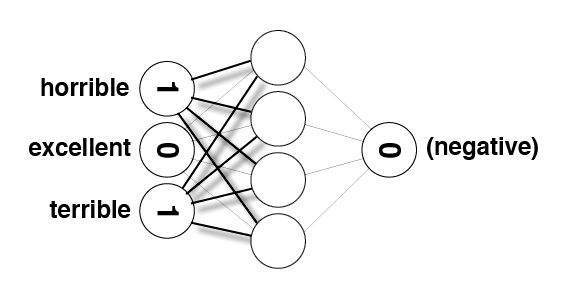

In [45]:
Image(filename='sentiment_network_sparse_2.png')

In [46]:
# words most frequently seen in a review with a "POSITIVE" label
pos_neg_ratios.most_common()

[('edie', 4.6913478822291435),
 ('antwone', 4.4773368144782069),
 ('din', 4.4067192472642533),
 ('gunga', 4.1896547420264252),
 ('goldsworthy', 4.1743872698956368),
 ('gypo', 4.0943445622221004),
 ('yokai', 4.0943445622221004),
 ('paulie', 4.0775374439057197),
 ('visconti', 3.9318256327243257),
 ('flavia', 3.9318256327243257),
 ('gundam', 3.4231762883809305),
 ('iturbi', 3.2771447329921766),
 ('felix', 3.1527360223636558),
 ('capote', 3.0122615755052013),
 ('fido', 3.0081547935525483),
 ('excellently', 2.9789251552376097),
 ('vance', 2.9444389791664403),
 ('kolchak', 2.9311937524164198),
 ('deanna', 2.9267394020670396),
 ('hayworth', 2.9267394020670396),
 ('sammo', 2.8526314299133175),
 ('sox', 2.8332133440562162),
 ('laputa', 2.8332133440562162),
 ('biko', 2.8332133440562162),
 ('polanski', 2.8233610476132043),
 ('alvin', 2.8183982582710754),
 ('matthau', 2.8067217286092401),
 ('mathieu', 2.7725887222397811),
 ('gilliam', 2.7245795030534206),
 ('victoria', 2.6810215287142909),
 ('chav

In [47]:
# words most frequently seen in a review with a "NEGATIVE" label
list(reversed(pos_neg_ratios.most_common()))[0:30]

[('boll', -4.9698132995760007),
 ('uwe', -4.6249728132842707),
 ('thunderbirds', -4.1271343850450917),
 ('beowulf', -4.1108738641733114),
 ('dahmer', -3.9889840465642745),
 ('wayans', -3.9318256327243257),
 ('seagal', -3.6441435602725449),
 ('gamera', -3.3322045101752038),
 ('dreck', -3.2708355637989119),
 ('unwatchable', -3.2580965380214821),
 ('stinker', -3.2088254890146994),
 ('mst', -2.9502698994772336),
 ('incoherent', -2.9368917735310576),
 ('flimsy', -2.9267394020670396),
 ('dillinger', -2.8332133440562162),
 ('yawn', -2.8183982582710754),
 ('unfunny', -2.6922395950755678),
 ('ugh', -2.6210388241125804),
 ('turd', -2.6210388241125804),
 ('waste', -2.6193845640165536),
 ('blah', -2.5704288232261625),
 ('slugs', -2.5649493574615367),
 ('tripe', -2.498699971920336),
 ('horrid', -2.4849066497880004),
 ('wtf', -2.4849066497880004),
 ('pointless', -2.4553061800117097),
 ('atrocious', -2.4259083090260445),
 ('damme', -2.4107986776342782),
 ('redeeming', -2.3682390632154826),
 ('prom', 

In [48]:
from bokeh.models import ColumnDataSource, LabelSet
from bokeh.plotting import figure, show, output_file
from bokeh.io import output_notebook
output_notebook()

Loading BokehJS ...

In [49]:
hist, edges = np.histogram(list(map(lambda x:x[1],pos_neg_ratios.most_common())), density=True, bins=100, normed=True)

p = figure(tools="pan,wheel_zoom,reset,save",
           toolbar_location="above",
           title="Word Positive/Negative Affinity Distribution")
p.quad(top=hist, bottom=0, left=edges[:-1], right=edges[1:], line_color="#555555")
show(p)

In [50]:
frequency_frequency = Counter()

for word, cnt in total_counts.most_common():
    frequency_frequency[cnt] += 1

In [51]:
hist, edges = np.histogram(list(map(lambda x:x[1],frequency_frequency.most_common())), density=True, bins=100, normed=True)

p = figure(tools="pan,wheel_zoom,reset,save",
           toolbar_location="above",
           title="The frequency distribution of the words in our corpus")
p.quad(top=hist, bottom=0, left=edges[:-1], right=edges[1:], line_color="#555555")
show(p)

# Project 6: Reducing Noise by Strategically Reducing the Vocabulary<a id='project_6'></a>

**TODO:** Improve `SentimentNetwork`'s performance by reducing more noise in the vocabulary. Specifically, do the following:
* Copy the `SentimentNetwork` class from the previous project into the following cell.
* Modify `pre_process_data`:
>* Add two additional parameters: `min_count` and `polarity_cutoff`
>* Calculate the positive-to-negative ratios of words used in the reviews. (You can use code you've written elsewhere in the notebook, but we are moving it into the class like we did with other helper code earlier.)
>* Andrew's solution only calculates a postive-to-negative ratio for words that occur at least 50 times. This keeps the network from attributing too much sentiment to rarer words. You can choose to add this to your solution if you would like.  
>* Change so words are only added to the vocabulary if they occur in the vocabulary more than `min_count` times.
>* Change so words are only added to the vocabulary if the absolute value of their postive-to-negative ratio is at least `polarity_cutoff`
* Modify `__init__`:
>* Add the same two parameters (`min_count` and `polarity_cutoff`) and use them when you call `pre_process_data`

In [56]:
# TODO: -Copy the SentimentNetwork class from Project 5 lesson
#       -Modify it according to the above instructions 

import time
import sys
import numpy as np

# Encapsulate our neural network in a class
class SentimentNetwork:
    def __init__(self, reviews,labels,min_count,polarity_cutoff,hidden_nodes = 10, learning_rate = 0.1):
        """Create a SentimenNetwork with the given settings
        Args:
            reviews(list) - List of reviews used for training
            labels(list) - List of POSITIVE/NEGATIVE labels associated with the given reviews
            hidden_nodes(int) - Number of nodes to create in the hidden layer
            learning_rate(float) - Learning rate to use while training
        
        """
        # Assign a seed to our random number generator to ensure we get
        # reproducable results during development 
        np.random.seed(1)

        # process the reviews and their associated labels so that everything
        # is ready for training
        self.pre_process_data(reviews, labels,min_count,polarity_cutoff)
        
        # Build the network to have the number of hidden nodes and the learning rate that
        # were passed into this initializer. Make the same number of input nodes as
        # there are vocabulary words and create a single output node.
        self.init_network(len(self.review_vocab),hidden_nodes, 1, learning_rate)

    def pre_process_data(self, reviews, labels,min_count,polarity_cutoff):
        
        # populate review_vocab with all of the words in the given reviews
        positive_counts = Counter()
        negative_counts = Counter()
        total_counts = Counter()
        
        for review,label in zip(reviews,labels):
    
            split_review = review.split(' ')
    
            for word in split_review:
        
                if label == 'POSITIVE':
                    positive_counts[word] +=1
                else:
                    negative_counts[word] +=1
                total_counts[word] +=1
        pos_neg_ratios = Counter()

        for word in total_counts:
            if total_counts[word] > min_count:
                 
                pos_neg_ratios[word] = np.log(positive_counts[word]/(negative_counts[word] +1))
       

        review_vocab = set()
        for review in reviews:
            for word in review.split(" "):
                if total_counts[word] > min_count and np.abs(pos_neg_ratios[word]) >=polarity_cutoff:                
                    review_vocab.add(word)

        # Convert the vocabulary set to a list so we can access words via indices
        self.review_vocab = list(review_vocab)
        print(len(self.review_vocab))
        # populate label_vocab with all of the words in the given labels.
        label_vocab = set()
        for label in labels:
            label_vocab.add(label)
        
        # Convert the label vocabulary set to a list so we can access labels via indices
        self.label_vocab = list(label_vocab)
        
        # Store the sizes of the review and label vocabularies.
        self.review_vocab_size = len(self.review_vocab)
        self.label_vocab_size = len(self.label_vocab)
        
        # Create a dictionary of words in the vocabulary mapped to index positions
        self.word2index = {}
        for i, word in enumerate(self.review_vocab):
            self.word2index[word] = i
        
        # Create a dictionary of labels mapped to index positions
        self.label2index = {}
        for i, label in enumerate(self.label_vocab):
            self.label2index[label] = i

    def init_network(self, input_nodes, hidden_nodes, output_nodes, learning_rate):
        # Set number of nodes in input, hidden and output layers.
        self.input_nodes = input_nodes
        self.hidden_nodes = hidden_nodes
        self.output_nodes = output_nodes

        # Store the learning rate
        self.learning_rate = learning_rate

        # Initialize weights

        # These are the weights between the input layer and the hidden layer.
        self.weights_0_1 = np.zeros((self.input_nodes,self.hidden_nodes))
      #  print("weights_0_1_shape",self.weights_0_1.shape)
        # These are the weights between the hidden layer and the output layer.
        self.weights_1_2 = np.random.normal(0.0, self.output_nodes**-0.5, 
                                                (self.hidden_nodes, self.output_nodes))
     #   print("weights_1_2_shape",self.weights_1_2.shape)
        ## New for Project 5: Removed self.layer_0; added self.layer_1
        # The input layer, a two-dimensional matrix with shape 1 x hidden_nodes
        self.layer_1 = np.zeros((1,hidden_nodes))
      #  print("layer1_weights", self.layer_1)
    
    ## New for Project 5: Removed update_input_layer function
    
    def get_target_for_label(self,label):
        if(label == 'POSITIVE'):
            return 1
        else:
            return 0
        
    def sigmoid(self,x):
        return 1 / (1 + np.exp(-x))
    
    def sigmoid_output_2_derivative(self,output):
        return output * (1 - output)
    
    ## New for Project 5: changed name of first parameter form 'training_reviews' 
    #                     to 'training_reviews_raw'
    def train(self, training_reviews_raw, training_labels):

        ## New for Project 5: pre-process training reviews so we can deal 
        #                     directly with the indices of non-zero inputs
        training_reviews = list()
        for review in training_reviews_raw:
            indices = set()
            for word in review.split(" "):
                if(word in self.word2index.keys()):
                    indices.add(self.word2index[word])
            training_reviews.append(list(indices))

        # make sure out we have a matching number of reviews and labels
        assert(len(training_reviews) == len(training_labels))
        
        # Keep track of correct predictions to display accuracy during training 
        correct_so_far = 0

        # Remember when we started for printing time statistics
        start = time.time()
        
        # loop through all the given reviews and run a forward and backward pass,
        # updating weights for every item
        for i in range(len(training_reviews)):
            
            # Get the next review and its correct label
            review = training_reviews[i]
            label = training_labels[i]
            
            #### Implement the forward pass here ####
            ### Forward pass ###

            ## New for Project 5: Removed call to 'update_input_layer' function
            #                     because 'layer_0' is no longer used

            # Hidden layer
            ## New for Project 5: Add in only the weights for non-zero items
            self.layer_1 *= 0
            for index in review:
                self.layer_1 += self.weights_0_1[index]
            
          #  print("layer_1_transpose",self.layer_1.shape)
            # Output layer
            ## New for Project 5: changed to use 'self.layer_1' instead of 'local layer_1'
            layer_2 = self.sigmoid(self.layer_1.dot(self.weights_1_2))            
            
            #### Implement the backward pass here ####
            ### Backward pass ###

            # Output error
            
            layer_2_error = layer_2 - self.get_target_for_label(label) # Output layer error is the difference between desired target and actual output.
            layer_2_delta = layer_2_error * self.sigmoid_output_2_derivative(layer_2)
           # print("layer_2_delta,", layer_2_delta.shape)
           
            # Backpropagated error
            layer_1_error = layer_2_delta.dot(self.weights_1_2.T) # errors propagated to the hidden layer
            layer_1_delta = layer_1_error # hidden layer gradients - no nonlinearity so it's the same as the error
          #  print("layer_1_delta,", layer_1_delta.shape)
            # Update the weights
            ## New for Project 5: changed to use 'self.layer_1' instead of local 'layer_1'
            self.weights_1_2 -= self.layer_1.T.dot(layer_2_delta) * self.learning_rate # update hidden-to-output weights with gradient descent step
            
            ## New for Project 5: Only update the weights that were used in the forward pass
            for index in review:
                self.weights_0_1[index] -= layer_1_delta[0] * self.learning_rate # update input-to-hidden weights with gradient descent step

            # Keep track of correct predictions.
            if(layer_2 >= 0.5 and label == 'POSITIVE'):
                correct_so_far += 1
            elif(layer_2 < 0.5 and label == 'NEGATIVE'):
                correct_so_far += 1
            
            # For debug purposes, print out our prediction accuracy and speed 
            # throughout the training process. 
            elapsed_time = float(time.time() - start)
            reviews_per_second = i / elapsed_time if elapsed_time > 0 else 0
            
            sys.stdout.write("\rProgress:" + str(100 * i/float(len(training_reviews)))[:4] \
                             + "% Speed(reviews/sec):" + str(reviews_per_second)[0:5] \
                             + " #Correct:" + str(correct_so_far) + " #Trained:" + str(i+1) \
                             + " Training Accuracy:" + str(correct_so_far * 100 / float(i+1))[:4] + "%")
            if(i % 2500 == 0):
                print("")
    
    def test(self, testing_reviews, testing_labels):
        """
        Attempts to predict the labels for the given testing_reviews,
        and uses the test_labels to calculate the accuracy of those predictions.
        """
        
        # keep track of how many correct predictions we make
        correct = 0

        # we'll time how many predictions per second we make
        start = time.time()

        # Loop through each of the given reviews and call run to predict
        # its label. 
        for i in range(len(testing_reviews)):
            pred = self.run(testing_reviews[i])
            if(pred == testing_labels[i]):
                correct += 1
            
            # For debug purposes, print out our prediction accuracy and speed 
            # throughout the prediction process. 

            elapsed_time = float(time.time() - start)
            reviews_per_second = i / elapsed_time if elapsed_time > 0 else 0
            
            sys.stdout.write("\rProgress:" + str(100 * i/float(len(testing_reviews)))[:4] \
                             + "% Speed(reviews/sec):" + str(reviews_per_second)[0:5] \
                             + " #Correct:" + str(correct) + " #Tested:" + str(i+1) \
                             + " Testing Accuracy:" + str(correct * 100 / float(i+1))[:4] + "%")
    
    def run(self, review):
        """
        Returns a POSITIVE or NEGATIVE prediction for the given review.
        """
        # Run a forward pass through the network, like in the "train" function.
        
        ## New for Project 5: Removed call to update_input_layer function
        #                     because layer_0 is no longer used

        # Hidden layer
        ## New for Project 5: Identify the indices used in the review and then add
        #                     just those weights to layer_1 
        self.layer_1 *= 0
        unique_indices = set()
        for word in review.lower().split(" "):
            if word in self.word2index.keys():
                unique_indices.add(self.word2index[word])
        for index in unique_indices:
            self.layer_1 += self.weights_0_1[index]
        
        # Output layer
        ## New for Project 5: changed to use self.layer_1 instead of local layer_1
        layer_2 = self.sigmoid(self.layer_1.dot(self.weights_1_2))
        
        # Return POSITIVE for values above greater-than-or-equal-to 0.5 in the output layer;
        # return NEGATIVE for other values
        if(layer_2[0] >= 0.5):
            return "POSITIVE"
        else:
            return "NEGATIVE"


Run the following cell to train your network with a small polarity cutoff.

In [70]:
mlp = SentimentNetwork(reviews[:-1000],labels[:-1000],min_count=20,polarity_cutoff=0.1,learning_rate=0.05)
mlp.train(reviews[:-1000]*20,labels[:-1000]*20)

/opt/conda/lib/python3.6/site-packages/ipykernel_launcher.py:55: RuntimeWarning: divide by zero encountered in log


10867
Progress:0.0% Speed(reviews/sec):0.0 #Correct:1 #Trained:1 Training Accuracy:100.%
Progress:0.52% Speed(reviews/sec):2145. #Correct:1958 #Trained:2501 Training Accuracy:78.2%
Progress:1.04% Speed(reviews/sec):2086. #Correct:3994 #Trained:5001 Training Accuracy:79.8%
Progress:1.56% Speed(reviews/sec):2086. #Correct:6097 #Trained:7501 Training Accuracy:81.2%
Progress:2.08% Speed(reviews/sec):1998. #Correct:8237 #Trained:10001 Training Accuracy:82.3%
Progress:2.60% Speed(reviews/sec):2015. #Correct:10398 #Trained:12501 Training Accuracy:83.1%
Progress:3.12% Speed(reviews/sec):2026. #Correct:12555 #Trained:15001 Training Accuracy:83.6%
Progress:3.64% Speed(reviews/sec):2029. #Correct:14688 #Trained:17501 Training Accuracy:83.9%
Progress:4.16% Speed(reviews/sec):2032. #Correct:16883 #Trained:20001 Training Accuracy:84.4%
Progress:4.68% Speed(reviews/sec):2035. #Correct:19078 #Trained:22501 Training Accuracy:84.7%
Progress:5.20% Speed(reviews/sec):2039. #Correct:21319 #Trained:25001 Tr

Progress:44.4% Speed(reviews/sec):2051. #Correct:198172 #Trained:213224 Training Accuracy:92.9%

Progress:44.4% Speed(reviews/sec):2050. #Correct:198390 #Trained:213454 Training Accuracy:92.9%

Progress:44.5% Speed(reviews/sec):2048. #Correct:198593 #Trained:213674 Training Accuracy:92.9%

Progress:44.6% Speed(reviews/sec):2048. #Correct:199013 #Trained:214115 Training Accuracy:92.9%

Progress:44.6% Speed(reviews/sec):2048. #Correct:199410 #Trained:214534 Training Accuracy:92.9%

Progress:44.7% Speed(reviews/sec):2048. #Correct:199817 #Trained:214956 Training Accuracy:92.9%

Progress:44.7% Speed(reviews/sec):2048. #Correct:199858 #Trained:215001 Training Accuracy:92.9%


Progress:44.9% Speed(reviews/sec):2048. #Correct:200614 #Trained:215780 Training Accuracy:92.9%

Progress:45.0% Speed(reviews/sec):2048. #Correct:201026 #Trained:216209 Training Accuracy:92.9%

Progress:45.1% Speed(reviews/sec):2048. #Correct:201440 #Trained:216636 Training Accuracy:92.9%

Progress:45.2% Speed(reviews/sec):2048. #Correct:201852 #Trained:217061 Training Accuracy:92.9%

Progress:45.3% Speed(reviews/sec):2048. #Correct:202274 #Trained:217501 Training Accuracy:92.9%

Progress:45.5% Speed(reviews/sec):2049. #Correct:203143 #Trained:218406 Training Accuracy:93.0%

Progress:45.5% Speed(reviews/sec):2049. #Correct:203542 #Trained:218819 Training Accuracy:93.0%

Progress:45.6% Speed(reviews/sec):2049. #Correct:203951 #Trained:219235 Training Accuracy:93.0%

Progress:45.7% Speed(reviews/sec):2049. #Correct:204338 #Trained:219644 Training Accuracy:93.0%

Progress:45.8% Speed(reviews/sec):2049. #Correct:204680 #Trained:220001 Training Accuracy:93.0%


Progress:45.9% Speed(reviews/sec):2049. #Correct:205193 #Trained:220535 Training Accuracy:93.0%

Progress:46.0% Speed(reviews/sec):2049. #Correct:205569 #Trained:220925 Training Accuracy:93.0%

Progress:46.1% Speed(reviews/sec):2049. #Correct:205981 #Trained:221357 Training Accuracy:93.0%

Progress:46.2% Speed(reviews/sec):2049. #Correct:206389 #Trained:221788 Training Accuracy:93.0%

Progress:46.2% Speed(reviews/sec):2049. #Correct:206789 #Trained:222199 Training Accuracy:93.0%

Progress:46.3% Speed(reviews/sec):2049. #Correct:207076 #Trained:222501 Training Accuracy:93.0%


Progress:46.4% Speed(reviews/sec):2050. #Correct:207632 #Trained:223080 Training Accuracy:93.0%

Progress:46.5% Speed(reviews/sec):2050. #Correct:208033 #Trained:223495 Training Accuracy:93.0%

Progress:46.6% Speed(reviews/sec):2050. #Correct:208455 #Trained:223932 Training Accuracy:93.0%

Progress:46.7% Speed(reviews/sec):2050. #Correct:208882 #Trained:224380 Training Accuracy:93.0%

Progress:46.8% Speed(reviews/sec):2050. #Correct:209301 #Trained:224819 Training Accuracy:93.0%

Progress:46.8% Speed(reviews/sec):2050. #Correct:209476 #Trained:225001 Training Accuracy:93.1%


Progress:47.0% Speed(reviews/sec):2050. #Correct:210129 #Trained:225679 Training Accuracy:93.1%

Progress:47.1% Speed(reviews/sec):2050. #Correct:210537 #Trained:226111 Training Accuracy:93.1%

Progress:47.1% Speed(reviews/sec):2051. #Correct:210942 #Trained:226532 Training Accuracy:93.1%

Progress:47.2% Speed(reviews/sec):2050. #Correct:211340 #Trained:226945 Training Accuracy:93.1%

Progress:47.3% Speed(reviews/sec):2050. #Correct:211736 #Trained:227354 Training Accuracy:93.1%

Progress:47.3% Speed(reviews/sec):2051. #Correct:211876 #Trained:227501 Training Accuracy:93.1%


Progress:47.5% Speed(reviews/sec):2050. #Correct:212541 #Trained:228200 Training Accuracy:93.1%

Progress:47.6% Speed(reviews/sec):2051. #Correct:212958 #Trained:228628 Training Accuracy:93.1%

Progress:47.7% Speed(reviews/sec):2050. #Correct:213351 #Trained:229039 Training Accuracy:93.1%

Progress:47.8% Speed(reviews/sec):2051. #Correct:213767 #Trained:229469 Training Accuracy:93.1%

Progress:47.8% Speed(reviews/sec):2050. #Correct:214160 #Trained:229877 Training Accuracy:93.1%

Progress:47.9% Speed(reviews/sec):2051. #Correct:214279 #Trained:230001 Training Accuracy:93.1%


Progress:48.0% Speed(reviews/sec):2051. #Correct:215006 #Trained:230757 Training Accuracy:93.1%

Progress:48.1% Speed(reviews/sec):2051. #Correct:215394 #Trained:231165 Training Accuracy:93.1%

Progress:48.2% Speed(reviews/sec):2051. #Correct:215782 #Trained:231569 Training Accuracy:93.1%

Progress:48.3% Speed(reviews/sec):2051. #Correct:216190 #Trained:232003 Training Accuracy:93.1%

Progress:48.4% Speed(reviews/sec):2051. #Correct:216582 #Trained:232422 Training Accuracy:93.1%

Progress:48.4% Speed(reviews/sec):2051. #Correct:216659 #Trained:232501 Training Accuracy:93.1%


Progress:48.5% Speed(reviews/sec):2051. #Correct:217377 #Trained:233253 Training Accuracy:93.1%

Progress:48.6% Speed(reviews/sec):2050. #Correct:217733 #Trained:233628 Training Accuracy:93.1%

Progress:48.7% Speed(reviews/sec):2050. #Correct:218131 #Trained:234038 Training Accuracy:93.2%

Progress:48.8% Speed(reviews/sec):2050. #Correct:218533 #Trained:234462 Training Accuracy:93.2%

Progress:48.9% Speed(reviews/sec):2050. #Correct:218961 #Trained:234900 Training Accuracy:93.2%

Progress:48.9% Speed(reviews/sec):2050. #Correct:219059 #Trained:235001 Training Accuracy:93.2%


Progress:49.1% Speed(reviews/sec):2050. #Correct:219770 #Trained:235734 Training Accuracy:93.2%

Progress:49.1% Speed(reviews/sec):2050. #Correct:220164 #Trained:236146 Training Accuracy:93.2%

Progress:49.2% Speed(reviews/sec):2050. #Correct:220563 #Trained:236556 Training Accuracy:93.2%

Progress:49.3% Speed(reviews/sec):2050. #Correct:220958 #Trained:236973 Training Accuracy:93.2%

Progress:49.4% Speed(reviews/sec):2050. #Correct:221374 #Trained:237406 Training Accuracy:93.2%

Progress:49.4% Speed(reviews/sec):2050. #Correct:221465 #Trained:237501 Training Accuracy:93.2%


Progress:49.6% Speed(reviews/sec):2050. #Correct:222164 #Trained:238232 Training Accuracy:93.2%

Progress:49.7% Speed(reviews/sec):2050. #Correct:222548 #Trained:238634 Training Accuracy:93.2%

Progress:49.8% Speed(reviews/sec):2050. #Correct:222989 #Trained:239091 Training Accuracy:93.2%

Progress:49.8% Speed(reviews/sec):2051. #Correct:223397 #Trained:239513 Training Accuracy:93.2%

Progress:49.9% Speed(reviews/sec):2050. #Correct:223798 #Trained:239923 Training Accuracy:93.2%

Progress:50.0% Speed(reviews/sec):2050. #Correct:223873 #Trained:240001 Training Accuracy:93.2%


Progress:50.1% Speed(reviews/sec):2051. #Correct:224619 #Trained:240778 Training Accuracy:93.2%

Progress:50.2% Speed(reviews/sec):2051. #Correct:225021 #Trained:241190 Training Accuracy:93.2%

Progress:50.3% Speed(reviews/sec):2051. #Correct:225435 #Trained:241620 Training Accuracy:93.3%

Progress:50.4% Speed(reviews/sec):2050. #Correct:225820 #Trained:242018 Training Accuracy:93.3%

Progress:50.5% Speed(reviews/sec):2051. #Correct:226228 #Trained:242449 Training Accuracy:93.3%

Progress:50.5% Speed(reviews/sec):2050. #Correct:226280 #Trained:242501 Training Accuracy:93.3%


Progress:50.6% Speed(reviews/sec):2051. #Correct:227057 #Trained:243292 Training Accuracy:93.3%

Progress:50.7% Speed(reviews/sec):2051. #Correct:227454 #Trained:243705 Training Accuracy:93.3%

Progress:50.8% Speed(reviews/sec):2051. #Correct:227891 #Trained:244154 Training Accuracy:93.3%

Progress:50.9% Speed(reviews/sec):2051. #Correct:228294 #Trained:244576 Training Accuracy:93.3%

Progress:51.0% Speed(reviews/sec):2051. #Correct:228661 #Trained:244963 Training Accuracy:93.3%

Progress:51.0% Speed(reviews/sec):2051. #Correct:228699 #Trained:245001 Training Accuracy:93.3%


Progress:51.2% Speed(reviews/sec):2051. #Correct:229500 #Trained:245838 Training Accuracy:93.3%

Progress:51.3% Speed(reviews/sec):2051. #Correct:229891 #Trained:246243 Training Accuracy:93.3%

Progress:51.3% Speed(reviews/sec):2051. #Correct:230308 #Trained:246686 Training Accuracy:93.3%

Progress:51.4% Speed(reviews/sec):2051. #Correct:230705 #Trained:247094 Training Accuracy:93.3%

Progress:51.5% Speed(reviews/sec):2051. #Correct:231098 #Trained:247501 Training Accuracy:93.3%


Progress:51.6% Speed(reviews/sec):2051. #Correct:231548 #Trained:247969 Training Accuracy:93.3%

Progress:51.7% Speed(reviews/sec):2051. #Correct:231918 #Trained:248357 Training Accuracy:93.3%

Progress:51.8% Speed(reviews/sec):2051. #Correct:232304 #Trained:248759 Training Accuracy:93.3%

Progress:51.9% Speed(reviews/sec):2051. #Correct:232712 #Trained:249179 Training Accuracy:93.3%

Progress:52.0% Speed(reviews/sec):2051. #Correct:233148 #Trained:249631 Training Accuracy:93.3%

Progress:52.0% Speed(reviews/sec):2051. #Correct:233502 #Trained:250001 Training Accuracy:93.4%


Progress:52.1% Speed(reviews/sec):2051. #Correct:233957 #Trained:250471 Training Accuracy:93.4%

Progress:52.2% Speed(reviews/sec):2051. #Correct:234363 #Trained:250891 Training Accuracy:93.4%

Progress:52.3% Speed(reviews/sec):2051. #Correct:234764 #Trained:251310 Training Accuracy:93.4%

Progress:52.4% Speed(reviews/sec):2051. #Correct:235182 #Trained:251744 Training Accuracy:93.4%

Progress:52.5% Speed(reviews/sec):2051. #Correct:235561 #Trained:252144 Training Accuracy:93.4%

Progress:52.6% Speed(reviews/sec):2051. #Correct:235905 #Trained:252501 Training Accuracy:93.4%


Progress:52.7% Speed(reviews/sec):2051. #Correct:236387 #Trained:253004 Training Accuracy:93.4%

Progress:52.7% Speed(reviews/sec):2051. #Correct:236800 #Trained:253433 Training Accuracy:93.4%

Progress:52.8% Speed(reviews/sec):2051. #Correct:237192 #Trained:253839 Training Accuracy:93.4%

Progress:52.9% Speed(reviews/sec):2051. #Correct:237621 #Trained:254285 Training Accuracy:93.4%

Progress:53.0% Speed(reviews/sec):2051. #Correct:238037 #Trained:254720 Training Accuracy:93.4%

Progress:53.1% Speed(reviews/sec):2051. #Correct:238307 #Trained:255001 Training Accuracy:93.4%


Progress:53.2% Speed(reviews/sec):2051. #Correct:238812 #Trained:255528 Training Accuracy:93.4%

Progress:53.3% Speed(reviews/sec):2051. #Correct:239234 #Trained:255968 Training Accuracy:93.4%

Progress:53.3% Speed(reviews/sec):2051. #Correct:239550 #Trained:256307 Training Accuracy:93.4%

Progress:53.4% Speed(reviews/sec):2049. #Correct:239754 #Trained:256522 Training Accuracy:93.4%

Progress:53.4% Speed(reviews/sec):2047. #Correct:239939 #Trained:256712 Training Accuracy:93.4%

Progress:53.5% Speed(reviews/sec):2046. #Correct:240163 #Trained:256946 Training Accuracy:93.4%

Progress:53.5% Speed(reviews/sec):2045. #Correct:240434 #Trained:257228 Training Accuracy:93.4%

Progress:53.6% Speed(reviews/sec):2043. #Correct:240620 #Trained:257424 Training Accuracy:93.4%

Progress:53.6% Speed(reviews/sec):2043. #Correct:240694 #Trained:257501 Training Accuracy:93.4%


Progress:53.8% Speed(reviews/sec):2043. #Correct:241420 #Trained:258258 Training Accuracy:93.4%

Progress:53.8% Speed(reviews/sec):2043. #Correct:241831 #Trained:258690 Training Accuracy:93.4%

Progress:53.9% Speed(reviews/sec):2043. #Correct:242238 #Trained:259111 Training Accuracy:93.4%

Progress:54.0% Speed(reviews/sec):2043. #Correct:242641 #Trained:259527 Training Accuracy:93.4%

Progress:54.1% Speed(reviews/sec):2043. #Correct:243036 #Trained:259936 Training Accuracy:93.4%

Progress:54.1% Speed(reviews/sec):2043. #Correct:243097 #Trained:260001 Training Accuracy:93.4%


Progress:54.3% Speed(reviews/sec):2043. #Correct:243829 #Trained:260765 Training Accuracy:93.5%

Progress:54.4% Speed(reviews/sec):2043. #Correct:244217 #Trained:261164 Training Accuracy:93.5%

Progress:54.4% Speed(reviews/sec):2043. #Correct:244627 #Trained:261593 Training Accuracy:93.5%

Progress:54.5% Speed(reviews/sec):2043. #Correct:245047 #Trained:262036 Training Accuracy:93.5%

Progress:54.6% Speed(reviews/sec):2043. #Correct:245456 #Trained:262459 Training Accuracy:93.5%

Progress:54.6% Speed(reviews/sec):2043. #Correct:245497 #Trained:262501 Training Accuracy:93.5%


Progress:54.8% Speed(reviews/sec):2044. #Correct:246270 #Trained:263307 Training Accuracy:93.5%

Progress:54.9% Speed(reviews/sec):2044. #Correct:246678 #Trained:263726 Training Accuracy:93.5%

Progress:55.0% Speed(reviews/sec):2043. #Correct:247056 #Trained:264111 Training Accuracy:93.5%

Progress:55.0% Speed(reviews/sec):2042. #Correct:247339 #Trained:264403 Training Accuracy:93.5%

Progress:55.1% Speed(reviews/sec):2042. #Correct:247731 #Trained:264812 Training Accuracy:93.5%

Progress:55.2% Speed(reviews/sec):2042. #Correct:247917 #Trained:265001 Training Accuracy:93.5%


Progress:55.3% Speed(reviews/sec):2043. #Correct:248587 #Trained:265693 Training Accuracy:93.5%

Progress:55.4% Speed(reviews/sec):2043. #Correct:249054 #Trained:266176 Training Accuracy:93.5%

Progress:55.5% Speed(reviews/sec):2043. #Correct:249434 #Trained:266575 Training Accuracy:93.5%

Progress:55.6% Speed(reviews/sec):2043. #Correct:249854 #Trained:267008 Training Accuracy:93.5%

Progress:55.7% Speed(reviews/sec):2043. #Correct:250244 #Trained:267413 Training Accuracy:93.5%

Progress:55.7% Speed(reviews/sec):2043. #Correct:250329 #Trained:267501 Training Accuracy:93.5%


Progress:55.8% Speed(reviews/sec):2043. #Correct:251096 #Trained:268287 Training Accuracy:93.5%

Progress:55.9% Speed(reviews/sec):2043. #Correct:251507 #Trained:268715 Training Accuracy:93.5%

Progress:56.0% Speed(reviews/sec):2043. #Correct:251889 #Trained:269118 Training Accuracy:93.5%

Progress:56.1% Speed(reviews/sec):2043. #Correct:252321 #Trained:269570 Training Accuracy:93.6%

Progress:56.2% Speed(reviews/sec):2043. #Correct:252725 #Trained:269989 Training Accuracy:93.6%

Progress:56.2% Speed(reviews/sec):2043. #Correct:252737 #Trained:270001 Training Accuracy:93.6%


Progress:56.4% Speed(reviews/sec):2044. #Correct:253544 #Trained:270845 Training Accuracy:93.6%

Progress:56.5% Speed(reviews/sec):2044. #Correct:253949 #Trained:271264 Training Accuracy:93.6%

Progress:56.6% Speed(reviews/sec):2044. #Correct:254361 #Trained:271691 Training Accuracy:93.6%

Progress:56.6% Speed(reviews/sec):2044. #Correct:254798 #Trained:272148 Training Accuracy:93.6%

Progress:56.7% Speed(reviews/sec):2044. #Correct:255139 #Trained:272501 Training Accuracy:93.6%


Progress:56.8% Speed(reviews/sec):2044. #Correct:255592 #Trained:272979 Training Accuracy:93.6%

Progress:56.9% Speed(reviews/sec):2044. #Correct:256024 #Trained:273421 Training Accuracy:93.6%

Progress:57.0% Speed(reviews/sec):2044. #Correct:256429 #Trained:273851 Training Accuracy:93.6%

Progress:57.1% Speed(reviews/sec):2044. #Correct:256834 #Trained:274271 Training Accuracy:93.6%

Progress:57.2% Speed(reviews/sec):2044. #Correct:257246 #Trained:274700 Training Accuracy:93.6%

Progress:57.2% Speed(reviews/sec):2044. #Correct:257539 #Trained:275001 Training Accuracy:93.6%


Progress:57.4% Speed(reviews/sec):2045. #Correct:258092 #Trained:275579 Training Accuracy:93.6%

Progress:57.4% Speed(reviews/sec):2045. #Correct:258490 #Trained:275993 Training Accuracy:93.6%

Progress:57.5% Speed(reviews/sec):2045. #Correct:258908 #Trained:276427 Training Accuracy:93.6%

Progress:57.6% Speed(reviews/sec):2045. #Correct:259297 #Trained:276826 Training Accuracy:93.6%

Progress:57.7% Speed(reviews/sec):2044. #Correct:259651 #Trained:277192 Training Accuracy:93.6%

Progress:57.8% Speed(reviews/sec):2044. #Correct:259949 #Trained:277501 Training Accuracy:93.6%


Progress:57.9% Speed(reviews/sec):2044. #Correct:260374 #Trained:277944 Training Accuracy:93.6%

Progress:57.9% Speed(reviews/sec):2044. #Correct:260797 #Trained:278385 Training Accuracy:93.6%

Progress:58.0% Speed(reviews/sec):2044. #Correct:261230 #Trained:278832 Training Accuracy:93.6%

Progress:58.1% Speed(reviews/sec):2044. #Correct:261614 #Trained:279239 Training Accuracy:93.6%

Progress:58.2% Speed(reviews/sec):2044. #Correct:261996 #Trained:279645 Training Accuracy:93.6%

Progress:58.3% Speed(reviews/sec):2044. #Correct:262341 #Trained:280001 Training Accuracy:93.6%


Progress:58.4% Speed(reviews/sec):2044. #Correct:262798 #Trained:280482 Training Accuracy:93.6%

Progress:58.5% Speed(reviews/sec):2044. #Correct:263189 #Trained:280890 Training Accuracy:93.6%

Progress:58.6% Speed(reviews/sec):2044. #Correct:263616 #Trained:281338 Training Accuracy:93.7%

Progress:58.6% Speed(reviews/sec):2044. #Correct:264000 #Trained:281745 Training Accuracy:93.7%

Progress:58.7% Speed(reviews/sec):2044. #Correct:264404 #Trained:282159 Training Accuracy:93.7%

Progress:58.8% Speed(reviews/sec):2044. #Correct:264734 #Trained:282501 Training Accuracy:93.7%


Progress:58.9% Speed(reviews/sec):2044. #Correct:265226 #Trained:283002 Training Accuracy:93.7%

Progress:59.0% Speed(reviews/sec):2044. #Correct:265645 #Trained:283431 Training Accuracy:93.7%

Progress:59.1% Speed(reviews/sec):2044. #Correct:266025 #Trained:283826 Training Accuracy:93.7%

Progress:59.2% Speed(reviews/sec):2044. #Correct:266409 #Trained:284225 Training Accuracy:93.7%

Progress:59.2% Speed(reviews/sec):2044. #Correct:266795 #Trained:284636 Training Accuracy:93.7%

Progress:59.3% Speed(reviews/sec):2044. #Correct:267144 #Trained:285001 Training Accuracy:93.7%


Progress:59.4% Speed(reviews/sec):2044. #Correct:267617 #Trained:285488 Training Accuracy:93.7%

Progress:59.5% Speed(reviews/sec):2044. #Correct:268025 #Trained:285918 Training Accuracy:93.7%

Progress:59.6% Speed(reviews/sec):2044. #Correct:268432 #Trained:286342 Training Accuracy:93.7%

Progress:59.7% Speed(reviews/sec):2044. #Correct:268820 #Trained:286744 Training Accuracy:93.7%

Progress:59.8% Speed(reviews/sec):2044. #Correct:269246 #Trained:287183 Training Accuracy:93.7%

Progress:59.8% Speed(reviews/sec):2044. #Correct:269548 #Trained:287501 Training Accuracy:93.7%


Progress:60.0% Speed(reviews/sec):2044. #Correct:270064 #Trained:288026 Training Accuracy:93.7%

Progress:60.0% Speed(reviews/sec):2044. #Correct:270484 #Trained:288457 Training Accuracy:93.7%

Progress:60.1% Speed(reviews/sec):2044. #Correct:270898 #Trained:288887 Training Accuracy:93.7%

Progress:60.2% Speed(reviews/sec):2044. #Correct:271318 #Trained:289320 Training Accuracy:93.7%

Progress:60.3% Speed(reviews/sec):2045. #Correct:271771 #Trained:289787 Training Accuracy:93.7%

Progress:60.4% Speed(reviews/sec):2045. #Correct:271979 #Trained:290001 Training Accuracy:93.7%


Progress:60.5% Speed(reviews/sec):2045. #Correct:272559 #Trained:290597 Training Accuracy:93.7%

Progress:60.6% Speed(reviews/sec):2045. #Correct:272984 #Trained:291030 Training Accuracy:93.7%

Progress:60.7% Speed(reviews/sec):2045. #Correct:273390 #Trained:291450 Training Accuracy:93.8%

Progress:60.8% Speed(reviews/sec):2045. #Correct:273816 #Trained:291885 Training Accuracy:93.8%

Progress:60.9% Speed(reviews/sec):2045. #Correct:274241 #Trained:292325 Training Accuracy:93.8%

Progress:60.9% Speed(reviews/sec):2045. #Correct:274412 #Trained:292501 Training Accuracy:93.8%


Progress:61.0% Speed(reviews/sec):2045. #Correct:275033 #Trained:293149 Training Accuracy:93.8%

Progress:61.1% Speed(reviews/sec):2045. #Correct:275449 #Trained:293587 Training Accuracy:93.8%

Progress:61.2% Speed(reviews/sec):2045. #Correct:275833 #Trained:293987 Training Accuracy:93.8%

Progress:61.3% Speed(reviews/sec):2045. #Correct:276227 #Trained:294393 Training Accuracy:93.8%

Progress:61.4% Speed(reviews/sec):2045. #Correct:276622 #Trained:294810 Training Accuracy:93.8%

Progress:61.4% Speed(reviews/sec):2045. #Correct:276807 #Trained:295001 Training Accuracy:93.8%


Progress:61.5% Speed(reviews/sec):2045. #Correct:277464 #Trained:295676 Training Accuracy:93.8%

Progress:61.6% Speed(reviews/sec):2045. #Correct:277890 #Trained:296125 Training Accuracy:93.8%

Progress:61.7% Speed(reviews/sec):2045. #Correct:278297 #Trained:296543 Training Accuracy:93.8%

Progress:61.8% Speed(reviews/sec):2045. #Correct:278694 #Trained:296964 Training Accuracy:93.8%

Progress:61.9% Speed(reviews/sec):2045. #Correct:279121 #Trained:297401 Training Accuracy:93.8%

Progress:61.9% Speed(reviews/sec):2045. #Correct:279218 #Trained:297501 Training Accuracy:93.8%


Progress:62.1% Speed(reviews/sec):2046. #Correct:279947 #Trained:298260 Training Accuracy:93.8%

Progress:62.2% Speed(reviews/sec):2046. #Correct:280343 #Trained:298677 Training Accuracy:93.8%

Progress:62.3% Speed(reviews/sec):2046. #Correct:280758 #Trained:299109 Training Accuracy:93.8%

Progress:62.4% Speed(reviews/sec):2046. #Correct:281174 #Trained:299540 Training Accuracy:93.8%

Progress:62.4% Speed(reviews/sec):2046. #Correct:281565 #Trained:299946 Training Accuracy:93.8%

Progress:62.5% Speed(reviews/sec):2046. #Correct:281617 #Trained:300001 Training Accuracy:93.8%


Progress:62.6% Speed(reviews/sec):2046. #Correct:282379 #Trained:300789 Training Accuracy:93.8%

Progress:62.7% Speed(reviews/sec):2046. #Correct:282805 #Trained:301231 Training Accuracy:93.8%

Progress:62.8% Speed(reviews/sec):2046. #Correct:283228 #Trained:301668 Training Accuracy:93.8%

Progress:62.9% Speed(reviews/sec):2046. #Correct:283652 #Trained:302106 Training Accuracy:93.8%

Progress:63.0% Speed(reviews/sec):2046. #Correct:284032 #Trained:302501 Training Accuracy:93.8%


Progress:63.1% Speed(reviews/sec):2046. #Correct:284415 #Trained:302897 Training Accuracy:93.8%

Progress:63.1% Speed(reviews/sec):2045. #Correct:284672 #Trained:303165 Training Accuracy:93.9%

Progress:63.2% Speed(reviews/sec):2045. #Correct:285072 #Trained:303575 Training Accuracy:93.9%

Progress:63.3% Speed(reviews/sec):2045. #Correct:285488 #Trained:304013 Training Accuracy:93.9%

Progress:63.4% Speed(reviews/sec):2045. #Correct:285894 #Trained:304440 Training Accuracy:93.9%

Progress:63.5% Speed(reviews/sec):2045. #Correct:286295 #Trained:304855 Training Accuracy:93.9%

Progress:63.5% Speed(reviews/sec):2045. #Correct:286434 #Trained:305001 Training Accuracy:93.9%


Progress:63.6% Speed(reviews/sec):2045. #Correct:287128 #Trained:305726 Training Accuracy:93.9%

Progress:63.7% Speed(reviews/sec):2045. #Correct:287534 #Trained:306146 Training Accuracy:93.9%

Progress:63.8% Speed(reviews/sec):2045. #Correct:287922 #Trained:306547 Training Accuracy:93.9%

Progress:63.9% Speed(reviews/sec):2045. #Correct:288365 #Trained:307001 Training Accuracy:93.9%

Progress:64.0% Speed(reviews/sec):2045. #Correct:288782 #Trained:307429 Training Accuracy:93.9%

Progress:64.0% Speed(reviews/sec):2045. #Correct:288852 #Trained:307501 Training Accuracy:93.9%


Progress:64.2% Speed(reviews/sec):2045. #Correct:289570 #Trained:308244 Training Accuracy:93.9%

Progress:64.3% Speed(reviews/sec):2045. #Correct:289961 #Trained:308655 Training Accuracy:93.9%

Progress:64.3% Speed(reviews/sec):2045. #Correct:290348 #Trained:309057 Training Accuracy:93.9%

Progress:64.4% Speed(reviews/sec):2045. #Correct:290772 #Trained:309493 Training Accuracy:93.9%

Progress:64.5% Speed(reviews/sec):2045. #Correct:291194 #Trained:309928 Training Accuracy:93.9%

Progress:64.5% Speed(reviews/sec):2045. #Correct:291265 #Trained:310001 Training Accuracy:93.9%


Progress:64.7% Speed(reviews/sec):2045. #Correct:291991 #Trained:310759 Training Accuracy:93.9%

Progress:64.8% Speed(reviews/sec):2045. #Correct:292420 #Trained:311200 Training Accuracy:93.9%

Progress:64.9% Speed(reviews/sec):2045. #Correct:292830 #Trained:311624 Training Accuracy:93.9%

Progress:65.0% Speed(reviews/sec):2046. #Correct:293249 #Trained:312051 Training Accuracy:93.9%

Progress:65.1% Speed(reviews/sec):2046. #Correct:293668 #Trained:312482 Training Accuracy:93.9%

Progress:65.1% Speed(reviews/sec):2046. #Correct:293687 #Trained:312501 Training Accuracy:93.9%


Progress:65.2% Speed(reviews/sec):2046. #Correct:294507 #Trained:313346 Training Accuracy:93.9%

Progress:65.3% Speed(reviews/sec):2046. #Correct:294972 #Trained:313828 Training Accuracy:93.9%

Progress:65.4% Speed(reviews/sec):2046. #Correct:295406 #Trained:314280 Training Accuracy:93.9%

Progress:65.5% Speed(reviews/sec):2046. #Correct:295804 #Trained:314690 Training Accuracy:93.9%

Progress:65.6% Speed(reviews/sec):2046. #Correct:296108 #Trained:315001 Training Accuracy:94.0%


Progress:65.7% Speed(reviews/sec):2046. #Correct:296602 #Trained:315523 Training Accuracy:94.0%

Progress:65.8% Speed(reviews/sec):2046. #Correct:296982 #Trained:315914 Training Accuracy:94.0%

Progress:65.9% Speed(reviews/sec):2046. #Correct:297416 #Trained:316360 Training Accuracy:94.0%

Progress:65.9% Speed(reviews/sec):2046. #Correct:297827 #Trained:316786 Training Accuracy:94.0%

Progress:66.0% Speed(reviews/sec):2046. #Correct:298212 #Trained:317193 Training Accuracy:94.0%

Progress:66.1% Speed(reviews/sec):2046. #Correct:298508 #Trained:317501 Training Accuracy:94.0%


Progress:66.2% Speed(reviews/sec):2047. #Correct:299051 #Trained:318065 Training Accuracy:94.0%

Progress:66.3% Speed(reviews/sec):2047. #Correct:299481 #Trained:318511 Training Accuracy:94.0%

Progress:66.4% Speed(reviews/sec):2047. #Correct:299888 #Trained:318936 Training Accuracy:94.0%

Progress:66.5% Speed(reviews/sec):2047. #Correct:300284 #Trained:319347 Training Accuracy:94.0%

Progress:66.6% Speed(reviews/sec):2047. #Correct:300706 #Trained:319778 Training Accuracy:94.0%

Progress:66.6% Speed(reviews/sec):2047. #Correct:300922 #Trained:320001 Training Accuracy:94.0%


Progress:66.8% Speed(reviews/sec):2047. #Correct:301550 #Trained:320658 Training Accuracy:94.0%

Progress:66.8% Speed(reviews/sec):2047. #Correct:301931 #Trained:321059 Training Accuracy:94.0%

Progress:66.9% Speed(reviews/sec):2047. #Correct:302354 #Trained:321494 Training Accuracy:94.0%

Progress:67.0% Speed(reviews/sec):2047. #Correct:302773 #Trained:321934 Training Accuracy:94.0%

Progress:67.1% Speed(reviews/sec):2047. #Correct:303195 #Trained:322366 Training Accuracy:94.0%

Progress:67.1% Speed(reviews/sec):2047. #Correct:303323 #Trained:322501 Training Accuracy:94.0%


Progress:67.3% Speed(reviews/sec):2047. #Correct:304016 #Trained:323219 Training Accuracy:94.0%

Progress:67.4% Speed(reviews/sec):2048. #Correct:304434 #Trained:323655 Training Accuracy:94.0%

Progress:67.5% Speed(reviews/sec):2048. #Correct:304835 #Trained:324072 Training Accuracy:94.0%

Progress:67.6% Speed(reviews/sec):2048. #Correct:305252 #Trained:324505 Training Accuracy:94.0%

Progress:67.6% Speed(reviews/sec):2048. #Correct:305657 #Trained:324923 Training Accuracy:94.0%

Progress:67.7% Speed(reviews/sec):2048. #Correct:305732 #Trained:325001 Training Accuracy:94.0%


Progress:67.8% Speed(reviews/sec):2048. #Correct:306471 #Trained:325765 Training Accuracy:94.0%

Progress:67.9% Speed(reviews/sec):2048. #Correct:306898 #Trained:326207 Training Accuracy:94.0%

Progress:68.0% Speed(reviews/sec):2047. #Correct:307117 #Trained:326434 Training Accuracy:94.0%

Progress:68.0% Speed(reviews/sec):2046. #Correct:307340 #Trained:326665 Training Accuracy:94.0%

Progress:68.0% Speed(reviews/sec):2044. #Correct:307534 #Trained:326862 Training Accuracy:94.0%

Progress:68.1% Speed(reviews/sec):2043. #Correct:307724 #Trained:327062 Training Accuracy:94.0%

Progress:68.1% Speed(reviews/sec):2042. #Correct:307918 #Trained:327262 Training Accuracy:94.0%

Progress:68.2% Speed(reviews/sec):2040. #Correct:308122 #Trained:327471 Training Accuracy:94.0%

Progress:68.2% Speed(reviews/sec):2040. #Correct:308152 #Trained:327501 Training Accuracy:94.0%


Progress:68.3% Speed(reviews/sec):2039. #Correct:308691 #Trained:328066 Training Accuracy:94.0%

Progress:68.3% Speed(reviews/sec):2038. #Correct:308891 #Trained:328279 Training Accuracy:94.0%

Progress:68.4% Speed(reviews/sec):2036. #Correct:309103 #Trained:328503 Training Accuracy:94.0%

Progress:68.5% Speed(reviews/sec):2036. #Correct:309407 #Trained:328821 Training Accuracy:94.0%

Progress:68.6% Speed(reviews/sec):2036. #Correct:309855 #Trained:329284 Training Accuracy:94.0%

Progress:68.6% Speed(reviews/sec):2036. #Correct:310255 #Trained:329699 Training Accuracy:94.1%

Progress:68.7% Speed(reviews/sec):2036. #Correct:310548 #Trained:330001 Training Accuracy:94.1%


Progress:68.8% Speed(reviews/sec):2036. #Correct:311052 #Trained:330525 Training Accuracy:94.1%

Progress:68.9% Speed(reviews/sec):2036. #Correct:311487 #Trained:330972 Training Accuracy:94.1%

Progress:69.0% Speed(reviews/sec):2036. #Correct:311910 #Trained:331406 Training Accuracy:94.1%

Progress:69.1% Speed(reviews/sec):2036. #Correct:312298 #Trained:331806 Training Accuracy:94.1%

Progress:69.2% Speed(reviews/sec):2036. #Correct:312693 #Trained:332212 Training Accuracy:94.1%

Progress:69.2% Speed(reviews/sec):2036. #Correct:312973 #Trained:332501 Training Accuracy:94.1%


Progress:69.3% Speed(reviews/sec):2036. #Correct:313482 #Trained:333034 Training Accuracy:94.1%

Progress:69.4% Speed(reviews/sec):2036. #Correct:313913 #Trained:333478 Training Accuracy:94.1%

Progress:69.5% Speed(reviews/sec):2037. #Correct:314326 #Trained:333910 Training Accuracy:94.1%

Progress:69.6% Speed(reviews/sec):2037. #Correct:314743 #Trained:334342 Training Accuracy:94.1%

Progress:69.7% Speed(reviews/sec):2037. #Correct:315138 #Trained:334750 Training Accuracy:94.1%

Progress:69.7% Speed(reviews/sec):2037. #Correct:315382 #Trained:335001 Training Accuracy:94.1%


Progress:69.9% Speed(reviews/sec):2037. #Correct:315955 #Trained:335599 Training Accuracy:94.1%

Progress:70.0% Speed(reviews/sec):2037. #Correct:316351 #Trained:336001 Training Accuracy:94.1%

Progress:70.0% Speed(reviews/sec):2037. #Correct:316765 #Trained:336426 Training Accuracy:94.1%

Progress:70.1% Speed(reviews/sec):2037. #Correct:317179 #Trained:336859 Training Accuracy:94.1%

Progress:70.2% Speed(reviews/sec):2037. #Correct:317595 #Trained:337286 Training Accuracy:94.1%

Progress:70.3% Speed(reviews/sec):2037. #Correct:317801 #Trained:337501 Training Accuracy:94.1%


Progress:70.4% Speed(reviews/sec):2037. #Correct:318453 #Trained:338179 Training Accuracy:94.1%

Progress:70.5% Speed(reviews/sec):2037. #Correct:318832 #Trained:338570 Training Accuracy:94.1%

Progress:70.6% Speed(reviews/sec):2037. #Correct:319249 #Trained:339000 Training Accuracy:94.1%

Progress:70.7% Speed(reviews/sec):2037. #Correct:319660 #Trained:339426 Training Accuracy:94.1%

Progress:70.8% Speed(reviews/sec):2037. #Correct:320080 #Trained:339857 Training Accuracy:94.1%

Progress:70.8% Speed(reviews/sec):2037. #Correct:320220 #Trained:340001 Training Accuracy:94.1%


Progress:70.9% Speed(reviews/sec):2037. #Correct:320911 #Trained:340720 Training Accuracy:94.1%

Progress:71.0% Speed(reviews/sec):2037. #Correct:321295 #Trained:341123 Training Accuracy:94.1%

Progress:71.1% Speed(reviews/sec):2038. #Correct:321735 #Trained:341580 Training Accuracy:94.1%

Progress:71.2% Speed(reviews/sec):2038. #Correct:322145 #Trained:342004 Training Accuracy:94.1%

Progress:71.3% Speed(reviews/sec):2038. #Correct:322554 #Trained:342426 Training Accuracy:94.1%

Progress:71.3% Speed(reviews/sec):2038. #Correct:322624 #Trained:342501 Training Accuracy:94.1%


Progress:71.5% Speed(reviews/sec):2038. #Correct:323369 #Trained:343269 Training Accuracy:94.2%

Progress:71.5% Speed(reviews/sec):2038. #Correct:323761 #Trained:343676 Training Accuracy:94.2%

Progress:71.6% Speed(reviews/sec):2038. #Correct:324192 #Trained:344125 Training Accuracy:94.2%

Progress:71.7% Speed(reviews/sec):2038. #Correct:324602 #Trained:344548 Training Accuracy:94.2%

Progress:71.8% Speed(reviews/sec):2038. #Correct:325009 #Trained:344970 Training Accuracy:94.2%

Progress:71.8% Speed(reviews/sec):2038. #Correct:325039 #Trained:345001 Training Accuracy:94.2%


Progress:72.0% Speed(reviews/sec):2038. #Correct:325870 #Trained:345860 Training Accuracy:94.2%

Progress:72.1% Speed(reviews/sec):2038. #Correct:326284 #Trained:346280 Training Accuracy:94.2%

Progress:72.2% Speed(reviews/sec):2038. #Correct:326696 #Trained:346709 Training Accuracy:94.2%

Progress:72.3% Speed(reviews/sec):2039. #Correct:327124 #Trained:347148 Training Accuracy:94.2%

Progress:72.3% Speed(reviews/sec):2039. #Correct:327463 #Trained:347501 Training Accuracy:94.2%


Progress:72.4% Speed(reviews/sec):2039. #Correct:327927 #Trained:347987 Training Accuracy:94.2%

Progress:72.5% Speed(reviews/sec):2039. #Correct:328348 #Trained:348425 Training Accuracy:94.2%

Progress:72.6% Speed(reviews/sec):2039. #Correct:328751 #Trained:348835 Training Accuracy:94.2%

Progress:72.7% Speed(reviews/sec):2039. #Correct:329169 #Trained:349270 Training Accuracy:94.2%

Progress:72.8% Speed(reviews/sec):2039. #Correct:329580 #Trained:349691 Training Accuracy:94.2%

Progress:72.9% Speed(reviews/sec):2039. #Correct:329878 #Trained:350001 Training Accuracy:94.2%


Progress:73.0% Speed(reviews/sec):2039. #Correct:330442 #Trained:350588 Training Accuracy:94.2%

Progress:73.1% Speed(reviews/sec):2039. #Correct:330836 #Trained:350999 Training Accuracy:94.2%

Progress:73.2% Speed(reviews/sec):2039. #Correct:331230 #Trained:351407 Training Accuracy:94.2%

Progress:73.2% Speed(reviews/sec):2039. #Correct:331648 #Trained:351839 Training Accuracy:94.2%

Progress:73.3% Speed(reviews/sec):2039. #Correct:332054 #Trained:352263 Training Accuracy:94.2%

Progress:73.4% Speed(reviews/sec):2039. #Correct:332280 #Trained:352501 Training Accuracy:94.2%


Progress:73.5% Speed(reviews/sec):2039. #Correct:332882 #Trained:353128 Training Accuracy:94.2%

Progress:73.6% Speed(reviews/sec):2039. #Correct:333298 #Trained:353558 Training Accuracy:94.2%

Progress:73.7% Speed(reviews/sec):2039. #Correct:333688 #Trained:353971 Training Accuracy:94.2%

Progress:73.8% Speed(reviews/sec):2040. #Correct:334097 #Trained:354397 Training Accuracy:94.2%

Progress:73.9% Speed(reviews/sec):2040. #Correct:334512 #Trained:354820 Training Accuracy:94.2%

Progress:73.9% Speed(reviews/sec):2040. #Correct:334687 #Trained:355001 Training Accuracy:94.2%


Progress:74.0% Speed(reviews/sec):2040. #Correct:335321 #Trained:355651 Training Accuracy:94.2%

Progress:74.1% Speed(reviews/sec):2040. #Correct:335727 #Trained:356074 Training Accuracy:94.2%

Progress:74.2% Speed(reviews/sec):2040. #Correct:336137 #Trained:356494 Training Accuracy:94.2%

Progress:74.3% Speed(reviews/sec):2040. #Correct:336533 #Trained:356909 Training Accuracy:94.2%

Progress:74.4% Speed(reviews/sec):2040. #Correct:336938 #Trained:357323 Training Accuracy:94.2%

Progress:74.4% Speed(reviews/sec):2040. #Correct:337107 #Trained:357501 Training Accuracy:94.2%


Progress:74.6% Speed(reviews/sec):2040. #Correct:337776 #Trained:358194 Training Accuracy:94.2%

Progress:74.7% Speed(reviews/sec):2040. #Correct:338177 #Trained:358610 Training Accuracy:94.3%

Progress:74.8% Speed(reviews/sec):2040. #Correct:338599 #Trained:359042 Training Accuracy:94.3%

Progress:74.8% Speed(reviews/sec):2040. #Correct:338993 #Trained:359450 Training Accuracy:94.3%

Progress:74.9% Speed(reviews/sec):2040. #Correct:339403 #Trained:359870 Training Accuracy:94.3%

Progress:75.0% Speed(reviews/sec):2040. #Correct:339533 #Trained:360001 Training Accuracy:94.3%


Progress:75.1% Speed(reviews/sec):2040. #Correct:340254 #Trained:360742 Training Accuracy:94.3%

Progress:75.2% Speed(reviews/sec):2040. #Correct:340676 #Trained:361173 Training Accuracy:94.3%

Progress:75.3% Speed(reviews/sec):2040. #Correct:341106 #Trained:361618 Training Accuracy:94.3%

Progress:75.4% Speed(reviews/sec):2041. #Correct:341577 #Trained:362100 Training Accuracy:94.3%

Progress:75.5% Speed(reviews/sec):2041. #Correct:341963 #Trained:362501 Training Accuracy:94.3%


Progress:75.6% Speed(reviews/sec):2041. #Correct:342376 #Trained:362923 Training Accuracy:94.3%

Progress:75.6% Speed(reviews/sec):2041. #Correct:342788 #Trained:363346 Training Accuracy:94.3%

Progress:75.7% Speed(reviews/sec):2041. #Correct:343195 #Trained:363763 Training Accuracy:94.3%

Progress:75.8% Speed(reviews/sec):2041. #Correct:343635 #Trained:364217 Training Accuracy:94.3%

Progress:75.9% Speed(reviews/sec):2041. #Correct:344059 #Trained:364655 Training Accuracy:94.3%

Progress:76.0% Speed(reviews/sec):2041. #Correct:344390 #Trained:365001 Training Accuracy:94.3%


Progress:76.1% Speed(reviews/sec):2041. #Correct:344843 #Trained:365472 Training Accuracy:94.3%

Progress:76.2% Speed(reviews/sec):2041. #Correct:345253 #Trained:365896 Training Accuracy:94.3%

Progress:76.3% Speed(reviews/sec):2041. #Correct:345659 #Trained:366312 Training Accuracy:94.3%

Progress:76.4% Speed(reviews/sec):2041. #Correct:346078 #Trained:366752 Training Accuracy:94.3%

Progress:76.4% Speed(reviews/sec):2041. #Correct:346466 #Trained:367152 Training Accuracy:94.3%

Progress:76.5% Speed(reviews/sec):2041. #Correct:346804 #Trained:367501 Training Accuracy:94.3%


Progress:76.6% Speed(reviews/sec):2041. #Correct:347316 #Trained:368029 Training Accuracy:94.3%

Progress:76.7% Speed(reviews/sec):2041. #Correct:347739 #Trained:368465 Training Accuracy:94.3%

Progress:76.8% Speed(reviews/sec):2041. #Correct:348155 #Trained:368897 Training Accuracy:94.3%

Progress:76.9% Speed(reviews/sec):2042. #Correct:348586 #Trained:369338 Training Accuracy:94.3%

Progress:77.0% Speed(reviews/sec):2042. #Correct:349006 #Trained:369772 Training Accuracy:94.3%

Progress:77.0% Speed(reviews/sec):2042. #Correct:349226 #Trained:370001 Training Accuracy:94.3%


Progress:77.2% Speed(reviews/sec):2042. #Correct:349839 #Trained:370638 Training Accuracy:94.3%

Progress:77.3% Speed(reviews/sec):2042. #Correct:350244 #Trained:371056 Training Accuracy:94.3%

Progress:77.3% Speed(reviews/sec):2042. #Correct:350662 #Trained:371488 Training Accuracy:94.3%

Progress:77.4% Speed(reviews/sec):2042. #Correct:351049 #Trained:371890 Training Accuracy:94.3%

Progress:77.5% Speed(reviews/sec):2042. #Correct:351480 #Trained:372340 Training Accuracy:94.3%

Progress:77.6% Speed(reviews/sec):2042. #Correct:351637 #Trained:372501 Training Accuracy:94.3%


Progress:77.7% Speed(reviews/sec):2042. #Correct:352293 #Trained:373180 Training Accuracy:94.4%

Progress:77.8% Speed(reviews/sec):2042. #Correct:352709 #Trained:373611 Training Accuracy:94.4%

Progress:77.9% Speed(reviews/sec):2042. #Correct:353128 #Trained:374042 Training Accuracy:94.4%

Progress:78.0% Speed(reviews/sec):2042. #Correct:353563 #Trained:374495 Training Accuracy:94.4%

Progress:78.1% Speed(reviews/sec):2042. #Correct:353964 #Trained:374907 Training Accuracy:94.4%

Progress:78.1% Speed(reviews/sec):2042. #Correct:354055 #Trained:375001 Training Accuracy:94.4%


Progress:78.2% Speed(reviews/sec):2042. #Correct:354756 #Trained:375733 Training Accuracy:94.4%

Progress:78.3% Speed(reviews/sec):2042. #Correct:355159 #Trained:376154 Training Accuracy:94.4%

Progress:78.4% Speed(reviews/sec):2042. #Correct:355567 #Trained:376575 Training Accuracy:94.4%

Progress:78.5% Speed(reviews/sec):2042. #Correct:355998 #Trained:377022 Training Accuracy:94.4%

Progress:78.6% Speed(reviews/sec):2043. #Correct:356410 #Trained:377451 Training Accuracy:94.4%

Progress:78.6% Speed(reviews/sec):2042. #Correct:356460 #Trained:377501 Training Accuracy:94.4%


Progress:78.8% Speed(reviews/sec):2042. #Correct:357211 #Trained:378279 Training Accuracy:94.4%

Progress:78.8% Speed(reviews/sec):2043. #Correct:357626 #Trained:378713 Training Accuracy:94.4%

Progress:78.9% Speed(reviews/sec):2043. #Correct:358037 #Trained:379138 Training Accuracy:94.4%

Progress:79.0% Speed(reviews/sec):2043. #Correct:358444 #Trained:379557 Training Accuracy:94.4%

Progress:79.1% Speed(reviews/sec):2043. #Correct:358849 #Trained:379974 Training Accuracy:94.4%

Progress:79.1% Speed(reviews/sec):2043. #Correct:358875 #Trained:380001 Training Accuracy:94.4%


Progress:79.3% Speed(reviews/sec):2043. #Correct:359643 #Trained:380797 Training Accuracy:94.4%

Progress:79.4% Speed(reviews/sec):2043. #Correct:360044 #Trained:381213 Training Accuracy:94.4%

Progress:79.5% Speed(reviews/sec):2043. #Correct:360469 #Trained:381654 Training Accuracy:94.4%

Progress:79.6% Speed(reviews/sec):2043. #Correct:360887 #Trained:382089 Training Accuracy:94.4%

Progress:79.6% Speed(reviews/sec):2043. #Correct:361288 #Trained:382501 Training Accuracy:94.4%


Progress:79.7% Speed(reviews/sec):2043. #Correct:361708 #Trained:382936 Training Accuracy:94.4%

Progress:79.8% Speed(reviews/sec):2043. #Correct:362123 #Trained:383363 Training Accuracy:94.4%

Progress:79.9% Speed(reviews/sec):2043. #Correct:362521 #Trained:383772 Training Accuracy:94.4%

Progress:80.0% Speed(reviews/sec):2043. #Correct:362930 #Trained:384197 Training Accuracy:94.4%

Progress:80.1% Speed(reviews/sec):2043. #Correct:363355 #Trained:384632 Training Accuracy:94.4%

Progress:80.2% Speed(reviews/sec):2043. #Correct:363712 #Trained:385001 Training Accuracy:94.4%


Progress:80.3% Speed(reviews/sec):2043. #Correct:364207 #Trained:385512 Training Accuracy:94.4%

Progress:80.4% Speed(reviews/sec):2044. #Correct:364668 #Trained:385984 Training Accuracy:94.4%

Progress:80.5% Speed(reviews/sec):2044. #Correct:365070 #Trained:386404 Training Accuracy:94.4%

Progress:80.5% Speed(reviews/sec):2044. #Correct:365485 #Trained:386829 Training Accuracy:94.4%

Progress:80.6% Speed(reviews/sec):2044. #Correct:365910 #Trained:387261 Training Accuracy:94.4%

Progress:80.7% Speed(reviews/sec):2044. #Correct:366139 #Trained:387501 Training Accuracy:94.4%


Progress:80.8% Speed(reviews/sec):2044. #Correct:366754 #Trained:388136 Training Accuracy:94.4%

Progress:80.9% Speed(reviews/sec):2044. #Correct:367173 #Trained:388571 Training Accuracy:94.4%

Progress:81.0% Speed(reviews/sec):2044. #Correct:367542 #Trained:388957 Training Accuracy:94.4%

Progress:81.1% Speed(reviews/sec):2044. #Correct:367973 #Trained:389403 Training Accuracy:94.4%

Progress:81.2% Speed(reviews/sec):2044. #Correct:368395 #Trained:389841 Training Accuracy:94.4%

Progress:81.2% Speed(reviews/sec):2044. #Correct:368550 #Trained:390001 Training Accuracy:94.4%


Progress:81.3% Speed(reviews/sec):2044. #Correct:369224 #Trained:390701 Training Accuracy:94.5%

Progress:81.4% Speed(reviews/sec):2044. #Correct:369630 #Trained:391117 Training Accuracy:94.5%

Progress:81.5% Speed(reviews/sec):2044. #Correct:370057 #Trained:391557 Training Accuracy:94.5%

Progress:81.6% Speed(reviews/sec):2045. #Correct:370499 #Trained:392010 Training Accuracy:94.5%

Progress:81.7% Speed(reviews/sec):2045. #Correct:370913 #Trained:392443 Training Accuracy:94.5%

Progress:81.7% Speed(reviews/sec):2045. #Correct:370971 #Trained:392501 Training Accuracy:94.5%


Progress:81.9% Speed(reviews/sec):2045. #Correct:371744 #Trained:393300 Training Accuracy:94.5%

Progress:82.0% Speed(reviews/sec):2045. #Correct:372168 #Trained:393735 Training Accuracy:94.5%

Progress:82.1% Speed(reviews/sec):2045. #Correct:372592 #Trained:394177 Training Accuracy:94.5%

Progress:82.2% Speed(reviews/sec):2045. #Correct:373002 #Trained:394605 Training Accuracy:94.5%

Progress:82.2% Speed(reviews/sec):2045. #Correct:373388 #Trained:395001 Training Accuracy:94.5%


Progress:82.3% Speed(reviews/sec):2045. #Correct:373804 #Trained:395432 Training Accuracy:94.5%

Progress:82.4% Speed(reviews/sec):2045. #Correct:374212 #Trained:395862 Training Accuracy:94.5%

Progress:82.5% Speed(reviews/sec):2045. #Correct:374633 #Trained:396302 Training Accuracy:94.5%

Progress:82.6% Speed(reviews/sec):2045. #Correct:375043 #Trained:396721 Training Accuracy:94.5%

Progress:82.7% Speed(reviews/sec):2045. #Correct:375441 #Trained:397138 Training Accuracy:94.5%

Progress:82.8% Speed(reviews/sec):2045. #Correct:375794 #Trained:397501 Training Accuracy:94.5%


Progress:82.9% Speed(reviews/sec):2045. #Correct:376290 #Trained:398015 Training Accuracy:94.5%

Progress:83.0% Speed(reviews/sec):2046. #Correct:376733 #Trained:398473 Training Accuracy:94.5%

Progress:83.1% Speed(reviews/sec):2046. #Correct:377138 #Trained:398888 Training Accuracy:94.5%

Progress:83.1% Speed(reviews/sec):2045. #Correct:377525 #Trained:399290 Training Accuracy:94.5%

Progress:83.2% Speed(reviews/sec):2046. #Correct:377938 #Trained:399718 Training Accuracy:94.5%

Progress:83.3% Speed(reviews/sec):2046. #Correct:378211 #Trained:400001 Training Accuracy:94.5%


Progress:83.4% Speed(reviews/sec):2046. #Correct:378763 #Trained:400576 Training Accuracy:94.5%

Progress:83.5% Speed(reviews/sec):2046. #Correct:379179 #Trained:401011 Training Accuracy:94.5%

Progress:83.6% Speed(reviews/sec):2046. #Correct:379599 #Trained:401446 Training Accuracy:94.5%

Progress:83.7% Speed(reviews/sec):2046. #Correct:379986 #Trained:401850 Training Accuracy:94.5%

Progress:83.8% Speed(reviews/sec):2046. #Correct:380405 #Trained:402279 Training Accuracy:94.5%

Progress:83.8% Speed(reviews/sec):2046. #Correct:380617 #Trained:402501 Training Accuracy:94.5%


Progress:83.9% Speed(reviews/sec):2046. #Correct:381231 #Trained:403125 Training Accuracy:94.5%

Progress:84.0% Speed(reviews/sec):2046. #Correct:381636 #Trained:403541 Training Accuracy:94.5%

Progress:84.1% Speed(reviews/sec):2046. #Correct:382033 #Trained:403950 Training Accuracy:94.5%

Progress:84.2% Speed(reviews/sec):2046. #Correct:382437 #Trained:404364 Training Accuracy:94.5%

Progress:84.3% Speed(reviews/sec):2046. #Correct:382820 #Trained:404768 Training Accuracy:94.5%

Progress:84.3% Speed(reviews/sec):2046. #Correct:383046 #Trained:405001 Training Accuracy:94.5%


Progress:84.5% Speed(reviews/sec):2046. #Correct:383656 #Trained:405628 Training Accuracy:94.5%

Progress:84.5% Speed(reviews/sec):2046. #Correct:384084 #Trained:406068 Training Accuracy:94.5%

Progress:84.6% Speed(reviews/sec):2046. #Correct:384498 #Trained:406494 Training Accuracy:94.5%

Progress:84.7% Speed(reviews/sec):2046. #Correct:384917 #Trained:406926 Training Accuracy:94.5%

Progress:84.8% Speed(reviews/sec):2046. #Correct:385321 #Trained:407345 Training Accuracy:94.5%

Progress:84.8% Speed(reviews/sec):2046. #Correct:385474 #Trained:407501 Training Accuracy:94.5%


Progress:85.0% Speed(reviews/sec):2046. #Correct:386152 #Trained:408193 Training Accuracy:94.6%

Progress:85.1% Speed(reviews/sec):2046. #Correct:386583 #Trained:408633 Training Accuracy:94.6%

Progress:85.2% Speed(reviews/sec):2046. #Correct:386990 #Trained:409050 Training Accuracy:94.6%

Progress:85.3% Speed(reviews/sec):2046. #Correct:387423 #Trained:409496 Training Accuracy:94.6%

Progress:85.4% Speed(reviews/sec):2047. #Correct:387886 #Trained:409968 Training Accuracy:94.6%

Progress:85.4% Speed(reviews/sec):2047. #Correct:387918 #Trained:410001 Training Accuracy:94.6%


Progress:85.5% Speed(reviews/sec):2047. #Correct:388726 #Trained:410834 Training Accuracy:94.6%

Progress:85.6% Speed(reviews/sec):2047. #Correct:389143 #Trained:411262 Training Accuracy:94.6%

Progress:85.7% Speed(reviews/sec):2047. #Correct:389555 #Trained:411687 Training Accuracy:94.6%

Progress:85.8% Speed(reviews/sec):2047. #Correct:389988 #Trained:412133 Training Accuracy:94.6%

Progress:85.9% Speed(reviews/sec):2047. #Correct:390344 #Trained:412501 Training Accuracy:94.6%


Progress:86.0% Speed(reviews/sec):2047. #Correct:390777 #Trained:412953 Training Accuracy:94.6%

Progress:86.1% Speed(reviews/sec):2047. #Correct:391210 #Trained:413397 Training Accuracy:94.6%

Progress:86.2% Speed(reviews/sec):2047. #Correct:391629 #Trained:413831 Training Accuracy:94.6%

Progress:86.3% Speed(reviews/sec):2047. #Correct:392036 #Trained:414249 Training Accuracy:94.6%

Progress:86.3% Speed(reviews/sec):2047. #Correct:392475 #Trained:414707 Training Accuracy:94.6%

Progress:86.4% Speed(reviews/sec):2047. #Correct:392763 #Trained:415001 Training Accuracy:94.6%


Progress:86.5% Speed(reviews/sec):2047. #Correct:393306 #Trained:415556 Training Accuracy:94.6%

Progress:86.6% Speed(reviews/sec):2048. #Correct:393742 #Trained:416003 Training Accuracy:94.6%

Progress:86.7% Speed(reviews/sec):2048. #Correct:394162 #Trained:416438 Training Accuracy:94.6%

Progress:86.8% Speed(reviews/sec):2048. #Correct:394585 #Trained:416874 Training Accuracy:94.6%

Progress:86.9% Speed(reviews/sec):2048. #Correct:395018 #Trained:417317 Training Accuracy:94.6%

Progress:86.9% Speed(reviews/sec):2048. #Correct:395196 #Trained:417501 Training Accuracy:94.6%


Progress:87.1% Speed(reviews/sec):2048. #Correct:395871 #Trained:418193 Training Accuracy:94.6%

Progress:87.2% Speed(reviews/sec):2048. #Correct:396294 #Trained:418630 Training Accuracy:94.6%

Progress:87.3% Speed(reviews/sec):2048. #Correct:396702 #Trained:419050 Training Accuracy:94.6%

Progress:87.3% Speed(reviews/sec):2048. #Correct:397132 #Trained:419496 Training Accuracy:94.6%

Progress:87.4% Speed(reviews/sec):2048. #Correct:397510 #Trained:419888 Training Accuracy:94.6%

Progress:87.5% Speed(reviews/sec):2048. #Correct:397619 #Trained:420001 Training Accuracy:94.6%


Progress:87.6% Speed(reviews/sec):2048. #Correct:398328 #Trained:420740 Training Accuracy:94.6%

Progress:87.7% Speed(reviews/sec):2048. #Correct:398745 #Trained:421170 Training Accuracy:94.6%

Progress:87.8% Speed(reviews/sec):2048. #Correct:399173 #Trained:421612 Training Accuracy:94.6%

Progress:87.9% Speed(reviews/sec):2048. #Correct:399589 #Trained:422039 Training Accuracy:94.6%

Progress:88.0% Speed(reviews/sec):2049. #Correct:400027 #Trained:422497 Training Accuracy:94.6%

Progress:88.0% Speed(reviews/sec):2049. #Correct:400031 #Trained:422501 Training Accuracy:94.6%


Progress:88.1% Speed(reviews/sec):2049. #Correct:400818 #Trained:423314 Training Accuracy:94.6%

Progress:88.2% Speed(reviews/sec):2049. #Correct:401230 #Trained:423741 Training Accuracy:94.6%

Progress:88.3% Speed(reviews/sec):2049. #Correct:401643 #Trained:424166 Training Accuracy:94.6%

Progress:88.4% Speed(reviews/sec):2049. #Correct:402050 #Trained:424587 Training Accuracy:94.6%

Progress:88.5% Speed(reviews/sec):2049. #Correct:402449 #Trained:425001 Training Accuracy:94.6%


Progress:88.6% Speed(reviews/sec):2049. #Correct:402896 #Trained:425463 Training Accuracy:94.6%

Progress:88.7% Speed(reviews/sec):2049. #Correct:403269 #Trained:425850 Training Accuracy:94.6%

Progress:88.8% Speed(reviews/sec):2049. #Correct:403678 #Trained:426268 Training Accuracy:94.7%

Progress:88.8% Speed(reviews/sec):2049. #Correct:404092 #Trained:426694 Training Accuracy:94.7%

Progress:88.9% Speed(reviews/sec):2049. #Correct:404505 #Trained:427112 Training Accuracy:94.7%

Progress:89.0% Speed(reviews/sec):2049. #Correct:404881 #Trained:427501 Training Accuracy:94.7%


Progress:89.1% Speed(reviews/sec):2049. #Correct:405311 #Trained:427945 Training Accuracy:94.7%

Progress:89.2% Speed(reviews/sec):2049. #Correct:405713 #Trained:428356 Training Accuracy:94.7%

Progress:89.3% Speed(reviews/sec):2049. #Correct:406100 #Trained:428764 Training Accuracy:94.7%

Progress:89.4% Speed(reviews/sec):2049. #Correct:406498 #Trained:429172 Training Accuracy:94.7%

Progress:89.5% Speed(reviews/sec):2049. #Correct:406925 #Trained:429615 Training Accuracy:94.7%

Progress:89.5% Speed(reviews/sec):2049. #Correct:407299 #Trained:430001 Training Accuracy:94.7%


Progress:89.6% Speed(reviews/sec):2049. #Correct:407744 #Trained:430461 Training Accuracy:94.7%

Progress:89.7% Speed(reviews/sec):2049. #Correct:408150 #Trained:430881 Training Accuracy:94.7%

Progress:89.8% Speed(reviews/sec):2049. #Correct:408554 #Trained:431293 Training Accuracy:94.7%

Progress:89.9% Speed(reviews/sec):2049. #Correct:408969 #Trained:431718 Training Accuracy:94.7%

Progress:90.0% Speed(reviews/sec):2049. #Correct:409381 #Trained:432138 Training Accuracy:94.7%

Progress:90.1% Speed(reviews/sec):2049. #Correct:409736 #Trained:432501 Training Accuracy:94.7%


Progress:90.2% Speed(reviews/sec):2049. #Correct:410220 #Trained:432999 Training Accuracy:94.7%

Progress:90.3% Speed(reviews/sec):2049. #Correct:410656 #Trained:433447 Training Accuracy:94.7%

Progress:90.3% Speed(reviews/sec):2049. #Correct:411123 #Trained:433920 Training Accuracy:94.7%

Progress:90.4% Speed(reviews/sec):2049. #Correct:411537 #Trained:434352 Training Accuracy:94.7%

Progress:90.5% Speed(reviews/sec):2049. #Correct:411950 #Trained:434774 Training Accuracy:94.7%

Progress:90.6% Speed(reviews/sec):2049. #Correct:412176 #Trained:435001 Training Accuracy:94.7%


Progress:90.7% Speed(reviews/sec):2049. #Correct:412773 #Trained:435617 Training Accuracy:94.7%

Progress:90.8% Speed(reviews/sec):2049. #Correct:413195 #Trained:436047 Training Accuracy:94.7%

Progress:90.9% Speed(reviews/sec):2049. #Correct:413602 #Trained:436465 Training Accuracy:94.7%

Progress:91.0% Speed(reviews/sec):2049. #Correct:413990 #Trained:436864 Training Accuracy:94.7%

Progress:91.1% Speed(reviews/sec):2049. #Correct:414390 #Trained:437281 Training Accuracy:94.7%

Progress:91.1% Speed(reviews/sec):2049. #Correct:414605 #Trained:437501 Training Accuracy:94.7%


Progress:91.2% Speed(reviews/sec):2049. #Correct:415206 #Trained:438122 Training Accuracy:94.7%

Progress:91.3% Speed(reviews/sec):2049. #Correct:415633 #Trained:438568 Training Accuracy:94.7%

Progress:91.4% Speed(reviews/sec):2049. #Correct:416034 #Trained:438978 Training Accuracy:94.7%

Progress:91.5% Speed(reviews/sec):2049. #Correct:416449 #Trained:439402 Training Accuracy:94.7%

Progress:91.6% Speed(reviews/sec):2050. #Correct:416883 #Trained:439847 Training Accuracy:94.7%

Progress:91.6% Speed(reviews/sec):2050. #Correct:417029 #Trained:440001 Training Accuracy:94.7%


Progress:91.8% Speed(reviews/sec):2050. #Correct:417737 #Trained:440731 Training Accuracy:94.7%

Progress:91.9% Speed(reviews/sec):2050. #Correct:418150 #Trained:441153 Training Accuracy:94.7%

Progress:92.0% Speed(reviews/sec):2050. #Correct:418590 #Trained:441605 Training Accuracy:94.7%

Progress:92.0% Speed(reviews/sec):2050. #Correct:419024 #Trained:442050 Training Accuracy:94.7%

Progress:92.1% Speed(reviews/sec):2050. #Correct:419442 #Trained:442483 Training Accuracy:94.7%

Progress:92.1% Speed(reviews/sec):2050. #Correct:419459 #Trained:442501 Training Accuracy:94.7%


Progress:92.3% Speed(reviews/sec):2050. #Correct:420267 #Trained:443331 Training Accuracy:94.7%

Progress:92.4% Speed(reviews/sec):2050. #Correct:420695 #Trained:443773 Training Accuracy:94.7%

Progress:92.5% Speed(reviews/sec):2050. #Correct:421097 #Trained:444195 Training Accuracy:94.8%

Progress:92.6% Speed(reviews/sec):2050. #Correct:421521 #Trained:444631 Training Accuracy:94.8%

Progress:92.7% Speed(reviews/sec):2050. #Correct:421879 #Trained:445001 Training Accuracy:94.8%


Progress:92.8% Speed(reviews/sec):2050. #Correct:422358 #Trained:445490 Training Accuracy:94.8%

Progress:92.8% Speed(reviews/sec):2050. #Correct:422772 #Trained:445916 Training Accuracy:94.8%

Progress:92.9% Speed(reviews/sec):2051. #Correct:423205 #Trained:446364 Training Accuracy:94.8%

Progress:93.0% Speed(reviews/sec):2051. #Correct:423628 #Trained:446797 Training Accuracy:94.8%

Progress:93.1% Speed(reviews/sec):2051. #Correct:424021 #Trained:447202 Training Accuracy:94.8%

Progress:93.2% Speed(reviews/sec):2051. #Correct:424313 #Trained:447501 Training Accuracy:94.8%


Progress:93.3% Speed(reviews/sec):2051. #Correct:424856 #Trained:448066 Training Accuracy:94.8%

Progress:93.4% Speed(reviews/sec):2051. #Correct:425273 #Trained:448501 Training Accuracy:94.8%

Progress:93.5% Speed(reviews/sec):2051. #Correct:425664 #Trained:448906 Training Accuracy:94.8%

Progress:93.6% Speed(reviews/sec):2051. #Correct:426086 #Trained:449339 Training Accuracy:94.8%

Progress:93.7% Speed(reviews/sec):2051. #Correct:426491 #Trained:449762 Training Accuracy:94.8%

Progress:93.7% Speed(reviews/sec):2051. #Correct:426729 #Trained:450001 Training Accuracy:94.8%


Progress:93.8% Speed(reviews/sec):2051. #Correct:427308 #Trained:450598 Training Accuracy:94.8%

Progress:93.9% Speed(reviews/sec):2051. #Correct:427735 #Trained:451030 Training Accuracy:94.8%

Progress:94.0% Speed(reviews/sec):2051. #Correct:428146 #Trained:451449 Training Accuracy:94.8%

Progress:94.1% Speed(reviews/sec):2051. #Correct:428536 #Trained:451850 Training Accuracy:94.8%

Progress:94.2% Speed(reviews/sec):2051. #Correct:428933 #Trained:452255 Training Accuracy:94.8%

Progress:94.2% Speed(reviews/sec):2051. #Correct:429171 #Trained:452501 Training Accuracy:94.8%


Progress:94.3% Speed(reviews/sec):2051. #Correct:429722 #Trained:453066 Training Accuracy:94.8%

Progress:94.4% Speed(reviews/sec):2051. #Correct:430135 #Trained:453489 Training Accuracy:94.8%

Progress:94.5% Speed(reviews/sec):2051. #Correct:430545 #Trained:453913 Training Accuracy:94.8%

Progress:94.6% Speed(reviews/sec):2051. #Correct:430942 #Trained:454323 Training Accuracy:94.8%

Progress:94.7% Speed(reviews/sec):2050. #Correct:431314 #Trained:454711 Training Accuracy:94.8%

Progress:94.7% Speed(reviews/sec):2051. #Correct:431597 #Trained:455001 Training Accuracy:94.8%


Progress:94.9% Speed(reviews/sec):2050. #Correct:432135 #Trained:455551 Training Accuracy:94.8%

Progress:94.9% Speed(reviews/sec):2050. #Correct:432521 #Trained:455941 Training Accuracy:94.8%

Progress:95.0% Speed(reviews/sec):2050. #Correct:432919 #Trained:456348 Training Accuracy:94.8%

Progress:95.1% Speed(reviews/sec):2050. #Correct:433336 #Trained:456777 Training Accuracy:94.8%

Progress:95.2% Speed(reviews/sec):2050. #Correct:433736 #Trained:457183 Training Accuracy:94.8%

Progress:95.3% Speed(reviews/sec):2050. #Correct:434045 #Trained:457501 Training Accuracy:94.8%


Progress:95.4% Speed(reviews/sec):2051. #Correct:434613 #Trained:458081 Training Accuracy:94.8%

Progress:95.5% Speed(reviews/sec):2051. #Correct:435008 #Trained:458490 Training Accuracy:94.8%

Progress:95.5% Speed(reviews/sec):2050. #Correct:435377 #Trained:458868 Training Accuracy:94.8%

Progress:95.6% Speed(reviews/sec):2050. #Correct:435762 #Trained:459261 Training Accuracy:94.8%

Progress:95.7% Speed(reviews/sec):2050. #Correct:436142 #Trained:459658 Training Accuracy:94.8%

Progress:95.8% Speed(reviews/sec):2050. #Correct:436480 #Trained:460001 Training Accuracy:94.8%


Progress:95.9% Speed(reviews/sec):2050. #Correct:436916 #Trained:460451 Training Accuracy:94.8%

Progress:96.0% Speed(reviews/sec):2050. #Correct:437282 #Trained:460826 Training Accuracy:94.8%

Progress:96.0% Speed(reviews/sec):2050. #Correct:437666 #Trained:461224 Training Accuracy:94.8%

Progress:96.1% Speed(reviews/sec):2050. #Correct:438079 #Trained:461657 Training Accuracy:94.8%

Progress:96.2% Speed(reviews/sec):2050. #Correct:438453 #Trained:462037 Training Accuracy:94.8%

Progress:96.3% Speed(reviews/sec):2049. #Correct:438786 #Trained:462382 Training Accuracy:94.8%

Progress:96.3% Speed(reviews/sec):2049. #Correct:438898 #Trained:462501 Training Accuracy:94.8%


Progress:96.4% Speed(reviews/sec):2049. #Correct:439557 #Trained:463175 Training Accuracy:94.9%

Progress:96.5% Speed(reviews/sec):2049. #Correct:439974 #Trained:463601 Training Accuracy:94.9%

Progress:96.6% Speed(reviews/sec):2049. #Correct:440386 #Trained:464026 Training Accuracy:94.9%

Progress:96.7% Speed(reviews/sec):2049. #Correct:440798 #Trained:464448 Training Accuracy:94.9%

Progress:96.8% Speed(reviews/sec):2049. #Correct:441195 #Trained:464857 Training Accuracy:94.9%

Progress:96.8% Speed(reviews/sec):2049. #Correct:441338 #Trained:465001 Training Accuracy:94.9%


Progress:97.0% Speed(reviews/sec):2049. #Correct:442012 #Trained:465697 Training Accuracy:94.9%

Progress:97.1% Speed(reviews/sec):2049. #Correct:442393 #Trained:466088 Training Accuracy:94.9%

Progress:97.1% Speed(reviews/sec):2049. #Correct:442752 #Trained:466460 Training Accuracy:94.9%

Progress:97.2% Speed(reviews/sec):2049. #Correct:443139 #Trained:466861 Training Accuracy:94.9%

Progress:97.3% Speed(reviews/sec):2049. #Correct:443527 #Trained:467262 Training Accuracy:94.9%

Progress:97.3% Speed(reviews/sec):2049. #Correct:443759 #Trained:467501 Training Accuracy:94.9%


Progress:97.5% Speed(reviews/sec):2049. #Correct:444336 #Trained:468098 Training Accuracy:94.9%

Progress:97.5% Speed(reviews/sec):2048. #Correct:444569 #Trained:468342 Training Accuracy:94.9%

Progress:97.6% Speed(reviews/sec):2047. #Correct:444749 #Trained:468526 Training Accuracy:94.9%

Progress:97.6% Speed(reviews/sec):2046. #Correct:444938 #Trained:468719 Training Accuracy:94.9%

Progress:97.6% Speed(reviews/sec):2045. #Correct:445133 #Trained:468921 Training Accuracy:94.9%

Progress:97.7% Speed(reviews/sec):2044. #Correct:445338 #Trained:469130 Training Accuracy:94.9%

Progress:97.7% Speed(reviews/sec):2043. #Correct:445560 #Trained:469359 Training Accuracy:94.9%

Progress:97.8% Speed(reviews/sec):2042. #Correct:445750 #Trained:469554 Training Accuracy:94.9%

Progress:97.8% Speed(reviews/sec):2041. #Correct:445950 #Trained:469762 Training Accuracy:94.9%

Progress:97.9% Speed(reviews/sec):2041. #Correct:446153 #Trained:469970 Training Accuracy:94.9%

Progress:97.9% Speed(reviews/sec):2040. #Correct:446182 #Trained:470001 Training Accuracy:94.9%


Progress:98.0% Speed(reviews/sec):2039. #Correct:446572 #Trained:470409 Training Accuracy:94.9%

Progress:98.0% Speed(reviews/sec):2038. #Correct:446784 #Trained:470627 Training Accuracy:94.9%

Progress:98.0% Speed(reviews/sec):2037. #Correct:446972 #Trained:470819 Training Accuracy:94.9%

Progress:98.1% Speed(reviews/sec):2036. #Correct:447163 #Trained:471015 Training Accuracy:94.9%

Progress:98.1% Speed(reviews/sec):2036. #Correct:447436 #Trained:471297 Training Accuracy:94.9%

Progress:98.2% Speed(reviews/sec):2036. #Correct:447833 #Trained:471709 Training Accuracy:94.9%

Progress:98.3% Speed(reviews/sec):2035. #Correct:448099 #Trained:471984 Training Accuracy:94.9%

Progress:98.3% Speed(reviews/sec):2034. #Correct:448294 #Trained:472185 Training Accuracy:94.9%

Progress:98.4% Speed(reviews/sec):2033. #Correct:448510 #Trained:472410 Training Accuracy:94.9%

Progress:98.4% Speed(reviews/sec):2033. #Correct:448598 #Trained:472501 Training Accuracy:94.9%


Progress:98.5% Speed(reviews/sec):2032. #Correct:448915 #Trained:472828 Training Accuracy:94.9%

Progress:98.5% Speed(reviews/sec):2032. #Correct:449290 #Trained:473217 Training Accuracy:94.9%

Progress:98.6% Speed(reviews/sec):2031. #Correct:449682 #Trained:473619 Training Accuracy:94.9%

Progress:98.7% Speed(reviews/sec):2031. #Correct:450071 #Trained:474018 Training Accuracy:94.9%

Progress:98.8% Speed(reviews/sec):2031. #Correct:450480 #Trained:474441 Training Accuracy:94.9%

Progress:98.9% Speed(reviews/sec):2031. #Correct:450901 #Trained:474868 Training Accuracy:94.9%

Progress:98.9% Speed(reviews/sec):2031. #Correct:451031 #Trained:475001 Training Accuracy:94.9%


Progress:99.1% Speed(reviews/sec):2031. #Correct:451701 #Trained:475685 Training Accuracy:94.9%

Progress:99.1% Speed(reviews/sec):2031. #Correct:452071 #Trained:476067 Training Accuracy:94.9%

Progress:99.2% Speed(reviews/sec):2031. #Correct:452467 #Trained:476472 Training Accuracy:94.9%

Progress:99.3% Speed(reviews/sec):2031. #Correct:452853 #Trained:476871 Training Accuracy:94.9%

Progress:99.4% Speed(reviews/sec):2031. #Correct:453253 #Trained:477286 Training Accuracy:94.9%

Progress:99.4% Speed(reviews/sec):2031. #Correct:453461 #Trained:477501 Training Accuracy:94.9%


Progress:99.6% Speed(reviews/sec):2031. #Correct:454093 #Trained:478150 Training Accuracy:94.9%

Progress:99.7% Speed(reviews/sec):2031. #Correct:454499 #Trained:478566 Training Accuracy:94.9%

Progress:99.7% Speed(reviews/sec):2031. #Correct:454898 #Trained:478977 Training Accuracy:94.9%

Progress:99.8% Speed(reviews/sec):2031. #Correct:455291 #Trained:479385 Training Accuracy:94.9%

Progress:99.9% Speed(reviews/sec):2031. #Correct:455685 #Trained:479787 Training Accuracy:94.9%

Progress:99.9% Speed(reviews/sec):2031. #Correct:455894 #Trained:480000 Training Accuracy:94.9%

And run the following cell to test it's performance. It should be 

In [73]:
mlp.test(reviews[-1000:]*2,labels[-1000:]*2)

Progress:24.4% Speed(reviews/sec):2403. #Correct:426 #Tested:489 Testing Accuracy:87.1%

Progress:49.5% Speed(reviews/sec):2431. #Correct:825 #Tested:992 Testing Accuracy:83.1%

Progress:74.0% Speed(reviews/sec):2420. #Correct:1250 #Tested:1481 Testing Accuracy:84.4%

Progress:99.0% Speed(reviews/sec):2427. #Correct:1645 #Tested:1981 Testing Accuracy:83.0%

Progress:99.9% Speed(reviews/sec):2412. #Correct:1662 #Tested:2000 Testing Accuracy:83.1%

Run the following cell to train your network with a much larger polarity cutoff.

In [ ]:
mlp = SentimentNetwork(reviews[:-1000],labels[:-1000],min_count=20,polarity_cutoff=0.8,learning_rate=0.01)
mlp.train(reviews[:-1000],labels[:-1000])

And run the following cell to test it's performance.

In [ ]:
mlp.test(reviews[-1000:],labels[-1000:])

# End of Project 6. 
## Watch the next video to see Andrew's solution, then continue on to the next lesson.

# Analysis: What's Going on in the Weights?<a id='lesson_7'></a>

In [74]:
mlp_full = SentimentNetwork(reviews[:-1000],labels[:-1000],min_count=0,polarity_cutoff=0,learning_rate=0.01)

/opt/conda/lib/python3.6/site-packages/ipykernel_launcher.py:55: RuntimeWarning: divide by zero encountered in log


72810


In [75]:
mlp_full.train(reviews[:-1000],labels[:-1000])

Progress:0.0% Speed(reviews/sec):0.0 #Correct:1 #Trained:1 Training Accuracy:100.%


Progress:2.59% Speed(reviews/sec):1533. #Correct:454 #Trained:623 Training Accuracy:72.8%

Progress:3.86% Speed(reviews/sec):1520. #Correct:693 #Trained:928 Training Accuracy:74.6%

Progress:5.17% Speed(reviews/sec):1527. #Correct:942 #Trained:1243 Training Accuracy:75.7%

Progress:6.5% Speed(reviews/sec):1534. #Correct:1193 #Trained:1561 Training Accuracy:76.4%

Progress:7.92% Speed(reviews/sec):1556. #Correct:1469 #Trained:1902 Training Accuracy:77.2%

Progress:9.24% Speed(reviews/sec):1557. #Correct:1740 #Trained:2220 Training Accuracy:78.3%

Progress:10.4% Speed(reviews/sec):1540. #Correct:1962 #Trained:2501 Training Accuracy:78.4%


Progress:11.6% Speed(reviews/sec):1528. #Correct:2226 #Trained:2804 Training Accuracy:79.3%

Progress:12.9% Speed(reviews/sec):1523. #Correct:2473 #Trained:3104 Training Accuracy:79.6%

Progress:14.1% Speed(reviews/sec):1519. #Correct:2714 #Trained:3407 Training Accuracy:79.6%

Progress:15.4% Speed(reviews/sec):1516. #Correct:2958 #Trained:3708 Training Accuracy:79.7%

Progress:16.7% Speed(reviews/sec):1521. #Correct:3222 #Trained:4029 Training Accuracy:79.9%

Progress:18.1% Speed(reviews/sec):1524. #Correct:3479 #Trained:4349 Training Accuracy:79.9%

Progress:19.3% Speed(reviews/sec):1521. #Correct:3716 #Trained:4650 Training Accuracy:79.9%

Progress:20.4% Speed(reviews/sec):1504. #Correct:3934 #Trained:4905 Training Accuracy:80.2%

Progress:20.8% Speed(reviews/sec):1503. #Correct:4002 #Trained:5001 Training Accuracy:80.0%


Progress:23.1% Speed(reviews/sec):1512. #Correct:4462 #Trained:5546 Training Accuracy:80.4%

Progress:24.3% Speed(reviews/sec):1510. #Correct:4715 #Trained:5849 Training Accuracy:80.6%

Progress:25.5% Speed(reviews/sec):1506. #Correct:4949 #Trained:6137 Training Accuracy:80.6%

Progress:26.8% Speed(reviews/sec):1508. #Correct:5225 #Trained:6455 Training Accuracy:80.9%

Progress:28.2% Speed(reviews/sec):1509. #Correct:5492 #Trained:6769 Training Accuracy:81.1%

Progress:29.4% Speed(reviews/sec):1508. #Correct:5756 #Trained:7071 Training Accuracy:81.4%

Progress:30.7% Speed(reviews/sec):1509. #Correct:6021 #Trained:7385 Training Accuracy:81.5%

Progress:31.2% Speed(reviews/sec):1507. #Correct:6120 #Trained:7501 Training Accuracy:81.5%


Progress:33.4% Speed(reviews/sec):1512. #Correct:6566 #Trained:8017 Training Accuracy:81.9%

Progress:34.7% Speed(reviews/sec):1514. #Correct:6839 #Trained:8335 Training Accuracy:82.0%

Progress:36.0% Speed(reviews/sec):1515. #Correct:7106 #Trained:8653 Training Accuracy:82.1%

Progress:37.2% Speed(reviews/sec):1513. #Correct:7364 #Trained:8950 Training Accuracy:82.2%

Progress:38.5% Speed(reviews/sec):1514. #Correct:7640 #Trained:9261 Training Accuracy:82.4%

Progress:39.9% Speed(reviews/sec):1516. #Correct:7907 #Trained:9583 Training Accuracy:82.5%

Progress:41.3% Speed(reviews/sec):1519. #Correct:8196 #Trained:9916 Training Accuracy:82.6%

Progress:41.6% Speed(reviews/sec):1518. #Correct:8271 #Trained:10001 Training Accuracy:82.7%


Progress:43.8% Speed(reviews/sec):1517. #Correct:8720 #Trained:10516 Training Accuracy:82.9%

Progress:45.0% Speed(reviews/sec):1515. #Correct:8977 #Trained:10816 Training Accuracy:82.9%

Progress:46.3% Speed(reviews/sec):1516. #Correct:9246 #Trained:11130 Training Accuracy:83.0%

Progress:47.6% Speed(reviews/sec):1514. #Correct:9497 #Trained:11428 Training Accuracy:83.1%

Progress:48.9% Speed(reviews/sec):1515. #Correct:9767 #Trained:11743 Training Accuracy:83.1%

Progress:50.1% Speed(reviews/sec):1514. #Correct:10032 #Trained:12041 Training Accuracy:83.3%

Progress:51.4% Speed(reviews/sec):1514. #Correct:10301 #Trained:12355 Training Accuracy:83.3%

Progress:52.0% Speed(reviews/sec):1513. #Correct:10431 #Trained:12501 Training Accuracy:83.4%


Progress:53.9% Speed(reviews/sec):1512. #Correct:10824 #Trained:12956 Training Accuracy:83.5%

Progress:55.3% Speed(reviews/sec):1514. #Correct:11100 #Trained:13275 Training Accuracy:83.6%

Progress:56.5% Speed(reviews/sec):1513. #Correct:11364 #Trained:13578 Training Accuracy:83.6%

Progress:57.8% Speed(reviews/sec):1512. #Correct:11629 #Trained:13882 Training Accuracy:83.7%

Progress:59.2% Speed(reviews/sec):1515. #Correct:11910 #Trained:14215 Training Accuracy:83.7%

Progress:60.6% Speed(reviews/sec):1517. #Correct:12181 #Trained:14545 Training Accuracy:83.7%

Progress:61.8% Speed(reviews/sec):1517. #Correct:12436 #Trained:14849 Training Accuracy:83.7%

Progress:62.5% Speed(reviews/sec):1516. #Correct:12565 #Trained:15001 Training Accuracy:83.7%


Progress:64.2% Speed(reviews/sec):1513. #Correct:12918 #Trained:15425 Training Accuracy:83.7%

Progress:65.5% Speed(reviews/sec):1513. #Correct:13180 #Trained:15740 Training Accuracy:83.7%

Progress:66.8% Speed(reviews/sec):1514. #Correct:13437 #Trained:16056 Training Accuracy:83.6%

Progress:68.1% Speed(reviews/sec):1513. #Correct:13694 #Trained:16359 Training Accuracy:83.7%

Progress:69.3% Speed(reviews/sec):1511. #Correct:13940 #Trained:16649 Training Accuracy:83.7%

Progress:70.6% Speed(reviews/sec):1512. #Correct:14207 #Trained:16967 Training Accuracy:83.7%

Progress:72.0% Speed(reviews/sec):1514. #Correct:14492 #Trained:17294 Training Accuracy:83.7%

Progress:72.9% Speed(reviews/sec):1513. #Correct:14670 #Trained:17501 Training Accuracy:83.8%


Progress:74.4% Speed(reviews/sec):1511. #Correct:14980 #Trained:17871 Training Accuracy:83.8%

Progress:75.7% Speed(reviews/sec):1510. #Correct:15235 #Trained:18170 Training Accuracy:83.8%

Progress:76.9% Speed(reviews/sec):1509. #Correct:15496 #Trained:18466 Training Accuracy:83.9%

Progress:78.2% Speed(reviews/sec):1510. #Correct:15780 #Trained:18783 Training Accuracy:84.0%

Progress:79.4% Speed(reviews/sec):1508. #Correct:16033 #Trained:19076 Training Accuracy:84.0%

Progress:80.8% Speed(reviews/sec):1510. #Correct:16318 #Trained:19399 Training Accuracy:84.1%

Progress:81.9% Speed(reviews/sec):1507. #Correct:16548 #Trained:19671 Training Accuracy:84.1%

Progress:83.2% Speed(reviews/sec):1506. #Correct:16806 #Trained:19971 Training Accuracy:84.1%

Progress:83.3% Speed(reviews/sec):1506. #Correct:16833 #Trained:20001 Training Accuracy:84.1%


Progress:85.6% Speed(reviews/sec):1504. #Correct:17324 #Trained:20559 Training Accuracy:84.2%

Progress:86.8% Speed(reviews/sec):1503. #Correct:17575 #Trained:20850 Training Accuracy:84.2%

Progress:88.1% Speed(reviews/sec):1503. #Correct:17833 #Trained:21147 Training Accuracy:84.3%

Progress:89.4% Speed(reviews/sec):1504. #Correct:18116 #Trained:21468 Training Accuracy:84.3%

Progress:90.7% Speed(reviews/sec):1504. #Correct:18389 #Trained:21781 Training Accuracy:84.4%

Progress:92.0% Speed(reviews/sec):1504. #Correct:18659 #Trained:22087 Training Accuracy:84.4%

Progress:93.3% Speed(reviews/sec):1505. #Correct:18929 #Trained:22402 Training Accuracy:84.4%

Progress:93.7% Speed(reviews/sec):1503. #Correct:19015 #Trained:22501 Training Accuracy:84.5%


Progress:95.1% Speed(reviews/sec):1494. #Correct:19309 #Trained:22846 Training Accuracy:84.5%

Progress:95.8% Speed(reviews/sec):1484. #Correct:19445 #Trained:23002 Training Accuracy:84.5%

Progress:96.4% Speed(reviews/sec):1475. #Correct:19582 #Trained:23153 Training Accuracy:84.5%

Progress:97.0% Speed(reviews/sec):1464. #Correct:19693 #Trained:23288 Training Accuracy:84.5%

Progress:97.6% Speed(reviews/sec):1455. #Correct:19823 #Trained:23439 Training Accuracy:84.5%

Progress:98.2% Speed(reviews/sec):1446. #Correct:19960 #Trained:23587 Training Accuracy:84.6%

Progress:98.8% Speed(reviews/sec):1438. #Correct:20092 #Trained:23735 Training Accuracy:84.6%

Progress:99.4% Speed(reviews/sec):1429. #Correct:20222 #Trained:23879 Training Accuracy:84.6%

Progress:99.9% Speed(reviews/sec):1423. #Correct:20335 #Trained:24000 Training Accuracy:84.7%

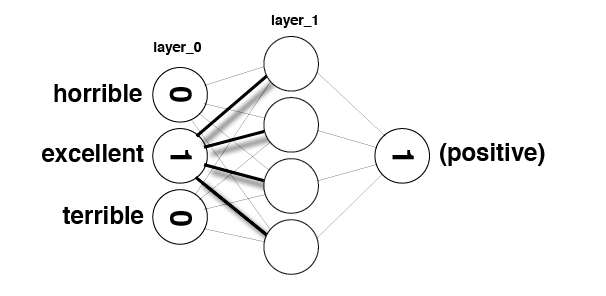

In [76]:
Image(filename='sentiment_network_sparse.png')

In [77]:
def get_most_similar_words(focus = "horrible"):
    most_similar = Counter()

    for word in mlp_full.word2index.keys():
        most_similar[word] = np.dot(mlp_full.weights_0_1[mlp_full.word2index[word]],mlp_full.weights_0_1[mlp_full.word2index[focus]])
    
    return most_similar.most_common()

In [78]:
get_most_similar_words("excellent")

[('excellent', 0.1367295075735247),
 ('perfect', 0.12548286087225941),
 ('amazing', 0.091827633925999713),
 ('today', 0.090223662694414217),
 ('wonderful', 0.089355976962214589),
 ('fun', 0.08750446667420686),
 ('great', 0.087141758882292045),
 ('best', 0.085810885617880611),
 ('liked', 0.077697629123843454),
 ('definitely', 0.076628781406966037),
 ('brilliant', 0.073423858769279052),
 ('loved', 0.073285428928122148),
 ('favorite', 0.072781136036160779),
 ('superb', 0.071736207178505068),
 ('fantastic', 0.070922191916266197),
 ('job', 0.069160617207634056),
 ('incredible', 0.066424077952614416),
 ('enjoyable', 0.065632560502888793),
 ('rare', 0.064819212662615075),
 ('highly', 0.063889453350970515),
 ('enjoyed', 0.062127546101812939),
 ('wonderfully', 0.062055178604090169),
 ('perfectly', 0.061093208811887401),
 ('fascinating', 0.060663547937493872),
 ('bit', 0.059655427045653055),
 ('gem', 0.059510859296156772),
 ('outstanding', 0.05886080814708302),
 ('beautiful', 0.05861393470316207

In [79]:
get_most_similar_words("terrible")

[('worst', 0.16966107259049851),
 ('awful', 0.12026847019691246),
 ('waste', 0.11945367265311004),
 ('poor', 0.09275888757443547),
 ('terrible', 0.091425387197727956),
 ('dull', 0.084209271678223632),
 ('poorly', 0.081241544516042027),
 ('disappointment', 0.080064759621368706),
 ('fails', 0.078599773723337513),
 ('disappointing', 0.07733948548032335),
 ('boring', 0.077127858748012895),
 ('unfortunately', 0.075502449705859079),
 ('worse', 0.070601835364194676),
 ('mess', 0.070564299623590399),
 ('stupid', 0.06948482283254305),
 ('badly', 0.066888903666228586),
 ('annoying', 0.065687021903374151),
 ('bad', 0.063093814537572124),
 ('save', 0.062880597495865734),
 ('disappointed', 0.062692353812072887),
 ('wasted', 0.061387183028051288),
 ('supposed', 0.060985452957725159),
 ('horrible', 0.060121772339380132),
 ('laughable', 0.058698406285467658),
 ('crap', 0.05810452866788457),
 ('basically', 0.057218840369636148),
 ('nothing', 0.057158220043034197),
 ('ridiculous', 0.056905481068931459),

In [80]:
import matplotlib.colors as colors

words_to_visualize = list()
for word, ratio in pos_neg_ratios.most_common(500):
    if(word in mlp_full.word2index.keys()):
        words_to_visualize.append(word)
    
for word, ratio in list(reversed(pos_neg_ratios.most_common()))[0:500]:
    if(word in mlp_full.word2index.keys()):
        words_to_visualize.append(word)

In [81]:
pos = 0
neg = 0

colors_list = list()
vectors_list = list()
for word in words_to_visualize:
    if word in pos_neg_ratios.keys():
        vectors_list.append(mlp_full.weights_0_1[mlp_full.word2index[word]])
        if(pos_neg_ratios[word] > 0):
            pos+=1
            colors_list.append("#00ff00")
        else:
            neg+=1
            colors_list.append("#000000")

In [105]:
from sklearn.manifold import TSNE
tsne = TSNE(n_components=2, random_state=0)
words_top_ted_tsne = tsne.fit_transform(vectors_list)

In [106]:
p = figure(tools="pan,wheel_zoom,reset,save",
           toolbar_location="above",
           title="vector T-SNE for most polarized words")

source = ColumnDataSource(data=dict(x1=words_top_ted_tsne[:,0],
                                    x2=words_top_ted_tsne[:,1],
                                   
                                    names=words_to_visualize,
                                    color=colors_list))

p.scatter(x="x1", y="x2", size=8, source=source, fill_color="color")

word_labels = LabelSet(x="x1", y="x2", text="names", y_offset=6,
                  text_font_size="8pt", text_color="#555555",
                  source=source, text_align='center')
#p.add_layout(word_labels)

show(p)

# green indicates positive words, black indicates negative words